In [20]:
import pandas as pd
import numpy as np
from dotenv import load_dotenv
import os
import warnings


# Load environment variables
_ = load_dotenv()

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

# Configuration to suppress warnings
warnings.filterwarnings('ignore')

# Additional configurations for better control over visualizations (optional)
plt.style.use('ggplot')  # For ggplot-like style in plots
pd.options.display.max_columns = None  # Ensure all columns are visible when displaying DataFrames


In [22]:
import matplotlib.dates as mdates
import plotly.express as px



In [87]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from statsmodels.tsa.stattools import adfuller
import plotly.graph_objects as go
from ipywidgets import interact, Dropdown
from plotly.subplots import make_subplots
import matplotlib.ticker as ticker
import statsmodels.api as sm


## Load the Dateset

In [24]:
# Define the path to the dataset
file_path = '/Users/aryasmc/My_USD/Year_2024/Summer_2024/Capstone_Project/Capstone_Project/RAW_Data/updated_data_715.csv'

# Load the dataset
df = pd.read_csv(file_path)

In [26]:
df.isnull().sum()

Unnamed: 0       0
time             0
low              0
high             0
open             0
close            0
volume           0
price_change     0
average_price    0
volatility       0
product_id       0
load_dt          0
dtype: int64

In [27]:
# Display the first few rows of the dataframe and the counts of unique product IDs
print("First few rows of the dataset:")
print(df.head())
print("\nCount of unique product IDs:")
print(df['product_id'].value_counts())

First few rows of the dataset:
   Unnamed: 0        time        low       high       open      close  \
0           0  2021-07-16  1850.1500  1965.3500  1918.9900  1877.2200   
1           1  2021-07-16   367.1000   410.5000   398.4500   367.8900   
2           2  2021-07-16    26.2040    29.4800    28.5750    26.2960   
3           3  2021-07-16    15.9297    17.5908    17.0647    16.3449   
4           4  2021-07-16     1.1661     1.2452     1.2249     1.1714   

         volume  price_change  average_price  volatility product_id  \
0  1.842217e+05      -41.7700     1907.75000    6.226522    ETH-USD   
1  2.381554e+04      -30.5600      388.80000   11.822392   COMP-USD   
2  3.369130e+05       -2.2790       27.84200   12.501908    SOL-USD   
3  5.165473e+05       -0.7198       16.76025   10.427692    UNI-USD   
4  3.676491e+07       -0.0535        1.20565    6.783295    ADA-USD   

      load_dt  
0  2024-07-15  
1  2024-07-15  
2  2024-07-15  
3  2024-07-15  
4  2024-07-15  

Count 

## Intitial Cleaning, Data Interpolation and Frequency Setting

In [28]:
# Remove the 'Unnamed: 0' column and other columns as it's redundant
df.drop(columns=['Unnamed: 0','load_dt'], inplace=True)

# Convert 'time' column to datetime format
df['time'] = pd.to_datetime(df['time'])

# Sort the DataFrame by the 'time' column
df.sort_values(by='time', ascending=True, inplace=True)

# Set 'time' as the index of the DataFrame
df.set_index('time', inplace=True)

# Calculate daily percentage change in 'close' price
df['pct_change'] = df['close'].pct_change() * 100  # multiply by 100 to convert to percentage

# Print the updated DataFrame to verify changes
print("Updated DataFrame with Daily Frequency and Interpolated Values:")
print(df.head())

# Review unique counts of product IDs if necessary
print("\nCount of unique product IDs:")
print(df['product_id'].value_counts())

Updated DataFrame with Daily Frequency and Interpolated Values:
                  low       high       open      close        volume  \
time                                                                   
2021-07-16  1850.1500  1965.3500  1918.9900  1877.2200  1.842217e+05   
2021-07-16   367.1000   410.5000   398.4500   367.8900  2.381554e+04   
2021-07-16    26.2040    29.4800    28.5750    26.2960  3.369130e+05   
2021-07-16    15.9297    17.5908    17.0647    16.3449  5.165473e+05   
2021-07-16     1.1661     1.2452     1.2249     1.1714  3.676491e+07   

            price_change  average_price  volatility product_id  pct_change  
time                                                                        
2021-07-16      -41.7700     1907.75000    6.226522    ETH-USD         NaN  
2021-07-16      -30.5600      388.80000   11.822392   COMP-USD  -80.402404  
2021-07-16       -2.2790       27.84200   12.501908    SOL-USD  -92.852211  
2021-07-16       -0.7198       16.76025   10.4

- Observations:
The data is well-formatted for time-series analysis, with the 'time' column set as the index and financial metrics properly organized.
The pct_change column is correctly calculated, with expected NaN values for the first entry of each cryptocurrency.
The product ID counts are consistent, with 1084 entries for most cryptocurrencies, except for AVAX-USD with 1008 entries, indicating potential missing data or a later start date.


In [29]:
df.head()

,low,high,open,close,volume,price_change,average_price,volatility,product_id,pct_change
time,,,,,,,,,,
2021-07-16,1850.1500,1965.3500,1918.9900,1877.2200,1.842217e+05,-41.7700,1907.75000,6.226522,ETH-USD,NaN
2021-07-16,367.1000,410.5000,398.4500,367.8900,2.381554e+04,-30.5600,388.80000,11.822392,COMP-USD,-80.402404
2021-07-16,26.2040,29.4800,28.5750,26.2960,3.369130e+05,-2.2790,27.84200,12.501908,SOL-USD,-92.852211
2021-07-16,15.9297,17.5908,17.0647,16.3449,5.165473e+05,-0.7198,16.76025,10.427692,UNI-USD,-37.842638
2021-07-16,1.1661,1.2452,1.2249,1.1714,3.676491e+07,-0.0535,1.20565,6.783295,ADA-USD,-92.833239


### Summary Statistics

In [30]:
# Identify numeric columns for statistical analysis
numeric_cols = df.select_dtypes(include=[np.number])  # This selects all the columns that are of numeric type

# Group by 'product_id' and calculate basic statistics for numeric columns
grouped_stats = df.groupby('product_id')[numeric_cols.columns].agg(['mean', 'std', 'min', 'max'])

# Calculate skewness and kurtosis separately using apply() for compatibility
skewness = df.groupby('product_id')[numeric_cols.columns].apply(lambda x: x.skew()).rename(columns=lambda x: x + '_skew')
kurtosis = df.groupby('product_id')[numeric_cols.columns].apply(lambda x: x.kurt()).rename(columns=lambda x: x + '_kurtosis')

# Concatenate the skewness and kurtosis DataFrames to the grouped_stats DataFrame
detailed_stats = pd.concat([grouped_stats, skewness, kurtosis], axis=1)

print("\nDetailed Summary Statistics by Cryptocurrency:")
print(detailed_stats)



Detailed Summary Statistics by Cryptocurrency:
             (low, mean)    (low, std)  (low, min)  (low, max)  (high, mean)  \
product_id                                                                     
ADA-USD         0.693826      0.568090      0.2300      2.9045      0.746372   
AVAX-USD       34.061974     26.731678      8.6200    126.2500     37.334038   
BTC-USD     36476.653718  15079.334679  15460.0000  71337.3000  38135.471125   
COMP-USD      102.054493    106.422680     23.1500    475.2200    111.350507   
ETH-USD      2306.483164    883.238030    879.8000   4697.9000   2436.128007   
LINK-USD       12.508462      6.847953      4.9260     33.4000     13.527634   
LTC-USD        92.019649     39.399077     40.3200    259.2000     98.274880   
MATIC-USD       0.984159      0.413650      0.3162      2.7131      1.067077   
SOL-USD        72.710804     58.815262      8.0000    245.8000     79.517627   
UNI-USD         9.205171      6.137585      3.3240     29.5190      9.98

- Volatility Insights: The detailed breakdown of volatility across cryptocurrencies assists in identifying which assets might require more stringent risk controls, especially in diversifying investment approaches.
- Price Behavior: The range in price statistics (minimum, maximum, mean, standard deviation) across different cryptocurrencies highlights the diverse investment thresholds and potential entry or exit points for traders.
- Market Response: High skewness and kurtosis values in certain cryptocurrencies suggest that some assets have responses to market news or events that are not normally distributed, potentially indicating a propensity for sudden large price moves or 'fat tails' in distribution.

### EDA

### Initial EDA

In [34]:
print(df.head())


                  low       high       open      close        volume  \
time                                                                   
2021-07-16  1850.1500  1965.3500  1918.9900  1877.2200  1.842217e+05   
2021-07-16   367.1000   410.5000   398.4500   367.8900  2.381554e+04   
2021-07-16    26.2040    29.4800    28.5750    26.2960  3.369130e+05   
2021-07-16    15.9297    17.5908    17.0647    16.3449  5.165473e+05   
2021-07-16     1.1661     1.2452     1.2249     1.1714  3.676491e+07   

            price_change  average_price  volatility product_id  pct_change  
time                                                                        
2021-07-16      -41.7700     1907.75000    6.226522    ETH-USD         NaN  
2021-07-16      -30.5600      388.80000   11.822392   COMP-USD  -80.402404  
2021-07-16       -2.2790       27.84200   12.501908    SOL-USD  -92.852211  
2021-07-16       -0.7198       16.76025   10.427692    UNI-USD  -37.842638  
2021-07-16       -0.0535        1

#### Interactive Time Series Plot

In [36]:
# Generate the interactive line plot
fig = px.line(df, x=df.index, y='pct_change', color='product_id', 
              title='Interactive Time Series of Percentage Changes',
              labels={'pct_change': 'Percentage Change (%)', 'product_id': 'Cryptocurrency'})

# Enhance the plot with a range slider for better navigation
fig.update_xaxes(rangeslider_visible=True)

# Update traces to be hidden by default
for trace in fig.data:
    trace.visible = 'legendonly'

fig.show()

### Distribution Analysis - Histograms

In [38]:
# Create a histogram of percentage changes to analyze the distribution
fig = px.histogram(df, x='pct_change', color='product_id',
                   marginal='box',  # adds a boxplot alongside the histogram
                   barmode='overlay',
                   nbins=100,  # adjust the number of bins for better resolution
                   title='Distribution of Percentage Changes by Cryptocurrency')

# Set all traces to be hidden by default, appear on legend click
for trace in fig.data:
    trace.visible = 'legendonly'

fig.update_layout(
    barmode='overlay',  # Overlays bars on top of each other
    bargap=0.1          # Sets gap between bars of adjacent location coordinates.
)

fig.show()

### Interactive Scatter Plot of Percentage Change vs. Volume

In [50]:
# Generate the scatter plot of percentage change vs volume
fig = px.scatter(df, x='volume', y='pct_change', color='product_id',
                 title='Volume vs. Percentage Change by Cryptocurrency',
                 labels={'volume': 'Trading Volume', 'pct_change': 'Percentage Change (%)'})

# Set all traces to be hidden by default, appear on legend click
for trace in fig.data:
    trace.visible = 'legendonly'

fig.show()

### Day of the Week Analysis

In [42]:
# Extract day of the week and map it to day names
df['day_of_week'] = df.index.dayofweek
day_map = {0: 'Monday', 1: 'Tuesday', 2: 'Wednesday', 3: 'Thursday', 4: 'Friday', 5: 'Saturday', 6: 'Sunday'}
df['day_name'] = df['day_of_week'].map(day_map)

# Calculate average percentage change by day of the week for each product
avg_pct_change_by_day = df.groupby(['product_id', 'day_of_week', 'day_name'])['pct_change'].mean().reset_index()

# Ensure the data is sorted by day of the week to avoid plotting issues
avg_pct_change_by_day.sort_values(by=['product_id', 'day_of_week'], inplace=True)

# Generate the interactive line plot
fig = px.line(avg_pct_change_by_day, x='day_name', y='pct_change', color='product_id',
              title='Average Percentage Change by Day of the Week',
              labels={'day_name': 'Day of the Week', 'pct_change': 'Average Percentage Change (%)'},
              category_orders={'day_name': ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']})

# Set all traces to be hidden by default, appear on legend click
for trace in fig.data:
    trace.visible = 'legendonly'

fig.show()


### Testing for Stationarity
Stationarity in time series data means that the statistical properties of the series like mean, variance, and autocorrelation do not change over time. For financial time series data like cryptocurrency percentage changes, ensuring stationarity is essential for making reliable forecasts.

In [49]:
def test_stationarity(timeseries, window=12):
    # Calculate rolling statistics
    rolling_mean = timeseries.rolling(window=window).mean()
    rolling_std = timeseries.rolling(window=window).std()

    # Prepare Plotly graph
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=timeseries.index, y=timeseries, name='Original', line=dict(color='blue')))
    fig.add_trace(go.Scatter(x=timeseries.index, y=rolling_mean, name='Rolling Mean', line=dict(color='red')))
    fig.add_trace(go.Scatter(x=timeseries.index, y=rolling_std, name='Rolling Std Dev', line=dict(color='black')))
    
    # Perform Dickey-Fuller test
    result = adfuller(timeseries.dropna(), autolag='AIC', maxlag=20)
    test_stat = result[0]
    p_value = result[1]
    critical_values = result[4]

    # Add Dickey-Fuller test results to the plot
    fig.update_layout(title=f'Dickey-Fuller Test: Test Statistic = {test_stat:.2f}, p-value = {p_value:.4f}',
                      xaxis_title='Time',
                      yaxis_title='Value',
                      showlegend=True)
    for key, value in critical_values.items():
        fig.add_hline(y=value, line_dash="dot",
                      annotation_text=f'Critical Value {key}', 
                      annotation_position="bottom right")
    
    fig.show()

# Dropdown to select cryptocurrency
dropdown = Dropdown(options=df['product_id'].unique())

# Function to update plot based on selected cryptocurrency
def update_plot(crypto):
    crypto_data = df[df['product_id'] == crypto]['pct_change']
    test_stationarity(crypto_data)

# Show dropdown and update plot based on selection
interact(update_plot, crypto=dropdown)

interactive(children=(Dropdown(description='crypto', options=('ETH-USD', 'COMP-USD', 'SOL-USD', 'UNI-USD', 'AD…

<function __main__.update_plot(crypto)>

#### Time Series Visualization with Trend Lines

In [53]:
# Create a subplot layout
fig = make_subplots(rows=len(df['product_id'].unique()), cols=1, shared_xaxes=True)

# Iterate over each unique cryptocurrency for plotting
for i, (label, df_product) in enumerate(df.groupby('product_id')):
    df_product = df_product.dropna(subset=['pct_change'])  # Drop NaN values for clean plotting
    if len(df_product) > 1:
        # Add line trace for percentage changes
        fig.add_trace(go.Scatter(x=df_product.index, y=df_product['pct_change'],
                                 mode='lines', name=f'{label} % Change'), row=i+1, col=1)
        
        # Add trend line using numpy's polyfit
        valid_dates = df_product.index
        coefficients = np.polyfit(range(len(df_product)), df_product['pct_change'], 1)
        trendline = np.polyval(coefficients, range(len(df_product)))
        fig.add_trace(go.Scatter(x=valid_dates, y=trendline,
                                 mode='lines', name=f'{label} Trend', line=dict(dash='dash')), row=i+1, col=1)

# Update layout to make it cleaner
fig.update_layout(height=900, width=1100, title_text="Percentage Change with Trend Lines by Cryptocurrency")
fig.update_xaxes(title_text="Time")
fig.update_yaxes(title_text="Percentage Change (%)", ticksuffix="%")

# Set all traces to be hidden by default, appear on legend click
for trace in fig.data:
    trace.visible = 'legendonly'

fig.show()


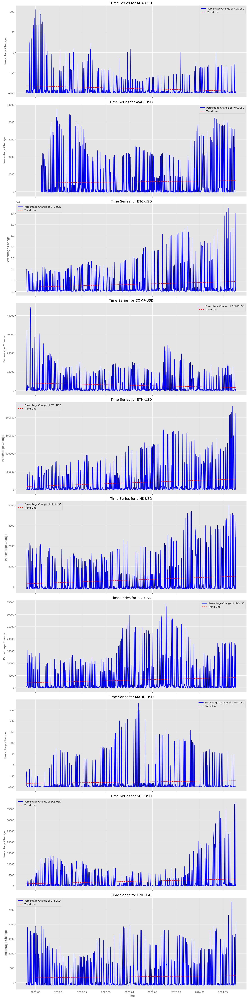

In [54]:
# Set the figure size and subplots
fig, axs = plt.subplots(len(df['product_id'].unique()), figsize=(15, 6 * len(df['product_id'].unique())), sharex=True)

# Ensure 'axs' is always an array, even with one product_id
axs = np.array(axs).reshape(-1)

# Iterate over each unique cryptocurrency for plotting
for i, (label, df_product) in enumerate(df.groupby('product_id')):
    # Ensure data for plotting is continuous and free of NaN values at the start
    df_product_nonan = df_product.dropna(subset=['pct_change'])
    
    axs[i].plot(df_product.index, df_product['pct_change'], label=f'Percentage Change of {label}', color='blue')
    
    # Only add a trend line if there are enough data points after dropping NaNs
    if len(df_product_nonan) > 1:  # ensure at least two data points are available
        valid_dates = mdates.date2num(df_product_nonan.index)  # convert dates to numerical format
        z = np.polyfit(valid_dates, df_product_nonan['pct_change'], 1)
        p = np.poly1d(z)
        axs[i].plot(df_product_nonan.index, p(valid_dates), "r--", label="Trend Line")
    
    axs[i].set_title(f'Time Series for {label}')
    axs[i].set_ylabel('Percentage Change')
    axs[i].legend()

plt.xlabel('Time')
plt.tight_layout()
plt.show()


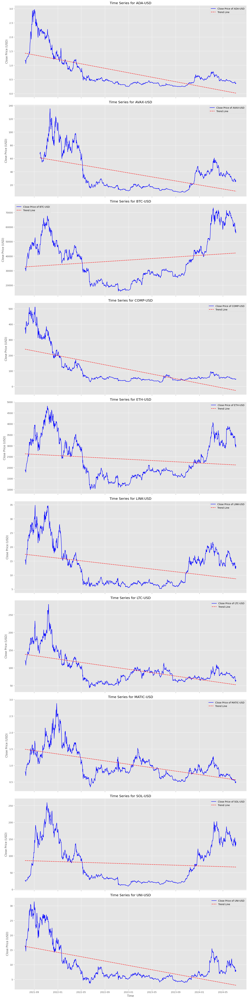

In [55]:
# Set the figure size and subplots
fig, axs = plt.subplots(len(df['product_id'].unique()), figsize=(15, 6 * len(df['product_id'].unique())), sharex=True)

# Iterate over each unique cryptocurrency for plotting
for i, (label, df_product) in enumerate(df.groupby('product_id')):
    axs[i].plot(df_product.index, df_product['close'], label=f'Close Price of {label}', color='blue')
    # Adding a trend line
    z = np.polyfit(mdates.date2num(df_product.index), df_product['close'], 1)
    p = np.poly1d(z)
    axs[i].plot(df_product.index, p(mdates.date2num(df_product.index)), "r--", label="Trend Line")
    axs[i].set_title(f'Time Series for {label}')
    axs[i].set_ylabel('Close Price (USD)')
    axs[i].legend()

plt.xlabel('Time')
plt.tight_layout()
plt.show()

This segment creates a subplot for each cryptocurrency with its close prices over time, enhanced with trend lines to easily visualize the overall direction of price movements.

## Data Cleaning & Feature Engineering

In [56]:
# Print the column names of the DataFrame
print(df.columns)


Index(['low', 'high', 'open', 'close', 'volume', 'price_change',
       'average_price', 'volatility', 'product_id', 'pct_change',
       'day_of_week', 'day_name'],
      dtype='object')


In [59]:
# Check if the DataFrame is sorted by time
is_sorted = df.index.is_monotonic_increasing
print(f"The DataFrame is sorted by time: {is_sorted}")


The DataFrame is sorted by time: True


In [57]:
# Print the DataFrame's index to check if 'time' is the index
print(df.index)


DatetimeIndex(['2021-07-16', '2021-07-16', '2021-07-16', '2021-07-16',
               '2021-07-16', '2021-07-16', '2021-07-16', '2021-07-16',
               '2021-07-16', '2021-07-17',
               ...
               '2024-07-08', '2024-07-08', '2024-07-08', '2024-07-08',
               '2024-07-08', '2024-07-08', '2024-07-08', '2024-07-08',
               '2024-07-08', '2024-07-08'],
              dtype='datetime64[ns]', name='time', length=10764, freq=None)


In [62]:
# Calculate daily percentage change in 'close' price
df['pct_change'] = df['close'].pct_change() * 100  # Convert to percentage

# Adding lag features for close prices and volume
for lag in [1, 3, 7]:  # Example lags: previous day, 3 days ago, and a week ago
    df[f'close_lag_{lag}'] = df['close'].shift(lag)
    df[f'volume_lag_{lag}'] = df['volume'].shift(lag)

# Calculate Moving Average (MA)
df['close_MA10'] = df['close'].rolling(window=10).mean()

# Calculate Exponential Moving Average (EMA) for different periods
for window in [7, 14, 30]:
    df[f'close_ema_{window}'] = df['close'].ewm(span=window, adjust=False).mean()

# Calculate Relative Strength Index (RSI)
delta = df['close'].diff()
gain = (delta.where(delta > 0, 0)).rolling(window=14).mean()
loss = (-delta.where(delta < 0, 0)).rolling(window=14).mean()
rs = gain / loss
df['RSI'] = 100 - (100 / (1 + rs))

# Calculate Moving Average Convergence Divergence (MACD)
exp1 = df['close'].ewm(span=12, adjust=False).mean()
exp2 = df['close'].ewm(span=26, adjust=False).mean()
df['MACD'] = exp1 - exp2
df['Signal_Line'] = df['MACD'].ewm(span=9, adjust=False).mean()

# Calculate Rolling Volatility
for window in [7, 14, 30]:
    df[f'volatility_{window}d'] = df['pct_change'].rolling(window=window).std() * np.sqrt(window)

# Calculate Market Momentum
for window in [1, 7, 30]:  # momentum over 1 day, 1 week, and 1 month
    df[f'momentum_{window}d'] = df['close'] / df['close'].shift(window) - 1

# Seasonal Indicators
df['day_of_week'] = df.index.dayofweek
df['month_of_year'] = df.index.month

# Clean up any resulting missing values before modeling
df.dropna(inplace=True)

# Define the split point for training and testing datasets in a time series manner
split_point = int(len(df) * 0.8)
train, test = df.iloc[:split_point], df.iloc[split_point:]

# Increase display settings for columns
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 1000)

# Print detailed information about the DataFrames
print("Training and Test set sizes:", train.shape, test.shape)
print("\nTraining data range: {} to {}".format(train.index.min(), train.index.max()))
print("Testing data range: {} to {}".format(test.index.min(), test.index.max()))

# Print full information on a few rows to understand the dataset structure better
print("\nDetailed sample of Training Set:")
print(train.head())

print("\nDetailed sample of Testing Set:")
print(test.head())


Training and Test set sizes: (8515, 32) (2129, 32)

Training data range: 2021-07-29 00:00:00 to 2023-12-08 00:00:00
Testing data range: 2023-12-08 00:00:00 to 2024-07-08 00:00:00

Detailed sample of Training Set:
                   low        high        open       close        volume  price_change  average_price  volatility product_id   pct_change  day_of_week  day_name  close_lag_1  volume_lag_1  close_lag_3   volume_lag_3  close_lag_7  volume_lag_7   close_MA10  close_ema_7  close_ema_14  close_ema_30        RSI         MACD  Signal_Line  volatility_7d  volatility_14d  volatility_30d  momentum_1d  momentum_7d  momentum_30d  month_of_year
time                                                                                                                                                                                                                                                                                                                                                           

The output confirms that the data has been successfully partitioned into training and testing sets, maintaining a clear chronological order, which is essential for time series analysis. Specifically, the training set encompasses data from July 29, 2021, to December 8, 2023, while the testing set begins immediately thereafter, spanning from December 8, 2023, to July 8, 2024. This split ensures that the temporal sequence is preserved, avoiding potential data leakage and making the setup suitable for subsequent time series forecasting models. The training set comprises 8,515 observations, and the testing set includes 2,129 observations, maintaining an approximate 80/20 split. This structured approach facilitates robust model training and validation phases, reflecting a sound methodological practice in time series analysis.

In [63]:
# Check DataFrame to confirm changes
print(df.describe())
print("\nDataFrame info:\n", df.info())


                low          high         open         close        volume  price_change  average_price    volatility    pct_change   day_of_week   close_lag_1  volume_lag_1   close_lag_3  volume_lag_3   close_lag_7  volume_lag_7    close_MA10   close_ema_7  close_ema_14  close_ema_30           RSI          MACD   Signal_Line  volatility_7d  volatility_14d  volatility_30d    momentum_1d    momentum_7d   momentum_30d  month_of_year
count  10644.000000  10644.000000  10644.00000  10644.000000  1.064400e+04  10644.000000   10644.000000  10644.000000  1.064400e+04  10644.000000  10644.000000  1.064400e+04  10644.000000  1.064400e+04  10644.000000  1.064400e+04  10644.000000  10644.000000  10644.000000  10644.000000  10644.000000  10644.000000  10644.000000   1.064400e+04    1.064400e+04    1.064400e+04   10644.000000   10644.000000   10644.000000   10644.000000
mean    3935.874569   4118.020282   4030.05552   4031.518859  1.045089e+07      1.463339    4026.947426      7.347134  1.362574e+0

## EDA

### Visualize Rolling Volatility

In [64]:

# Interactive plot for rolling volatility
fig = px.line(df.reset_index(), x='time', y='volatility_30d', color='product_id',
              labels={'volatility_30d': '30-Day Volatility'},
              title='30-Day Rolling Volatility for Each Cryptocurrency')

# Update to make individual lines selectable
fig.update_traces(visible="legendonly")  # Make all lines invisible by default; they appear when clicked in legend.

fig.update_xaxes(rangeslider_visible=True)
fig.show()

### Interactive Market Momentum

In [65]:
# Interactive plot for market momentum
fig_momentum = px.line(df.reset_index(), x='time', y='momentum_30d', color='product_id',
                       labels={'momentum_30d': '30-Day Momentum'},
                       title='30-Day Market Momentum for Each Cryptocurrency')

# Update to make individual lines selectable
fig_momentum.update_traces(visible="legendonly")  # Make all lines invisible by default; they appear when clicked in legend.

fig_momentum.update_xaxes(rangeslider_visible=True)
fig_momentum.show()

### Interactive Box Plot for Seasonal Patterns

In [67]:
# Mapping numerical days to day names
days = {0: 'Monday', 1: 'Tuesday', 2: 'Wednesday', 3: 'Thursday', 4: 'Friday', 5: 'Saturday', 6: 'Sunday'}
df['day_name'] = df['day_of_week'].map(days)

# Interactive box plot for day of the week effects, focusing on percentage change
fig_season = px.box(df.reset_index(), x='day_name', y='pct_change', color='product_id',
                    labels={'day_name': 'Day of the Week', 'pct_change': 'Percentage Change'},
                    title='Percentage Change Distribution by Day of Week for Each Cryptocurrency')

# Update the traces to be toggleable via the legend, this is a workaround since 'legendonly' isn't directly available
for trace in fig_season.data:
    trace.visible = "legendonly"  # Hide all traces; they appear when their legend entry is clicked.

fig_season.show()

### Interactive Exponential Moving Averages and Percentage Change

In [68]:
# Interactive plot for EMA and Percentage Changes
fig_ema = px.line(df.reset_index(), x='time', y=['pct_change', 'close_ema_30'], color='product_id',
                  labels={'value': 'Percentage', 'variable': 'Type'},
                  title='Percentage Changes and 30-Day Exponential Moving Averages')

# Update the traces to make individual lines selectable via the legend
fig_ema.update_traces(visible="legendonly")  # Make all lines invisible by default; they appear when clicked in legend.

fig_ema.update_xaxes(rangeslider_visible=True)
fig_ema.show()

In [69]:
# Data preparation
df_long = df.reset_index().melt(id_vars=['time', 'product_id'], value_vars=['pct_change', 'close_ema_30'],
                                var_name='Type', value_name='Value')

# Interactive plot for EMA and Percentage Changes
fig_ema = px.line(df_long, x='time', y='Value', color='product_id', line_dash='Type',
                  labels={'Value': 'Percentage', 'Type': 'Metric'},
                  title='Percentage Changes and 30-Day Exponential Moving Averages',
                  color_discrete_map={'pct_change': 'blue', 'close_ema_30': 'red'})

# Update the traces to make individual lines selectable via the legend
fig_ema.for_each_trace(lambda t: t.update(visible="legendonly"))

# Customization for a clearer legend and range slider
fig_ema.update_traces(mode='lines')
fig_ema.update_xaxes(rangeslider_visible=True)
fig_ema.update_layout(legend_title_text='Cryptocurrency and Metric')

fig_ema.show()

### Analysis of Percentage Changes and 30-Day EMAs Across Cryptocurrencies

In [70]:
# Data preparation for plotting
df_eda = df.reset_index().melt(id_vars=['time', 'product_id'], value_vars=['pct_change', 'close_ema_30'],
                                var_name='Metric', value_name='Value')

# Interactive plot for Percentage Changes and 30-Day Exponential Moving Averages
fig_ema = px.line(df_eda, x='time', y='Value', color='product_id', line_dash='Metric',
                  labels={'Value': 'Percentage', 'Metric': 'Metric Type'},
                  title='Analysis of Percentage Changes and 30-Day EMAs Across Cryptocurrencies',
                  color_discrete_map={'pct_change': 'blue', 'close_ema_30': 'red'})

# Update the traces to make individual lines selectable via the legend
fig_ema.for_each_trace(lambda t: t.update(visible="legendonly"))

# Customize plot to enhance clarity
fig_ema.update_traces(mode='lines')
fig_ema.update_xaxes(rangeslider_visible=True)
fig_ema.update_layout(legend_title_text='Cryptocurrency and Metric')

fig_ema.show()

### Distribution of 'Percentage Change' of Prices for Each Cryptocurrency

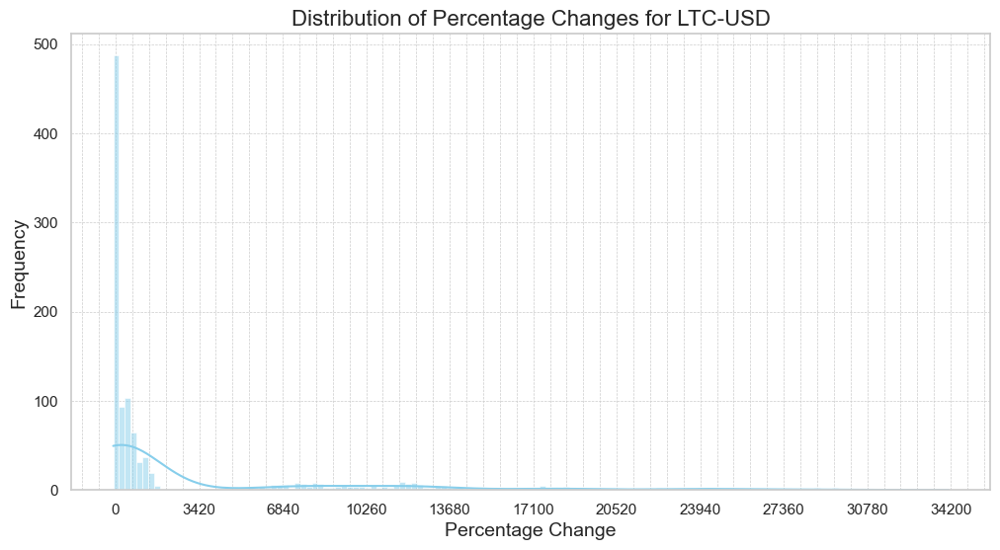

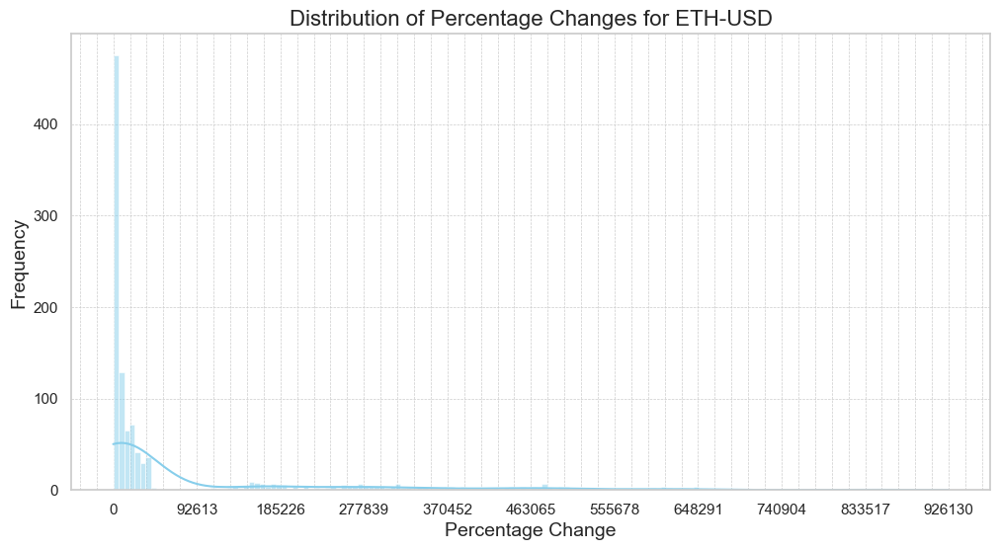

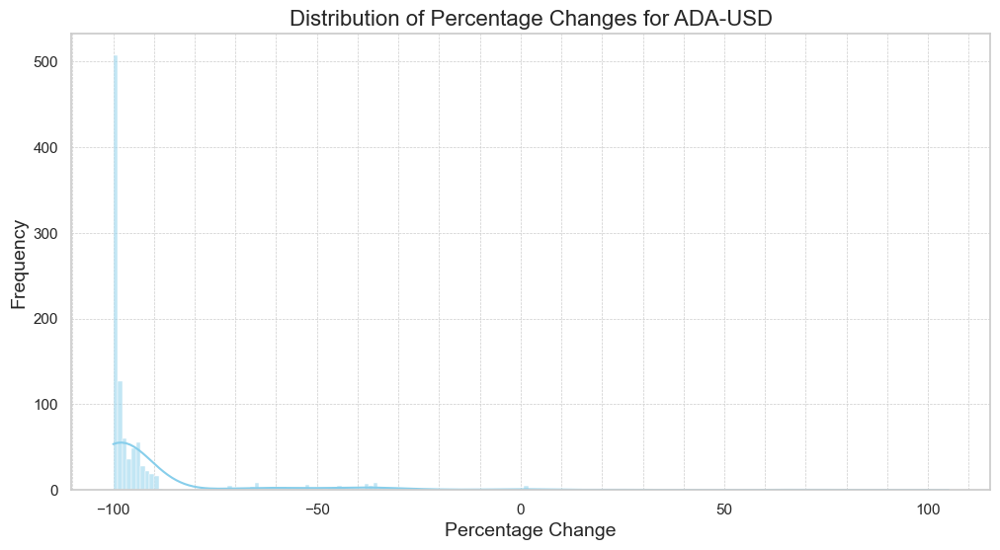

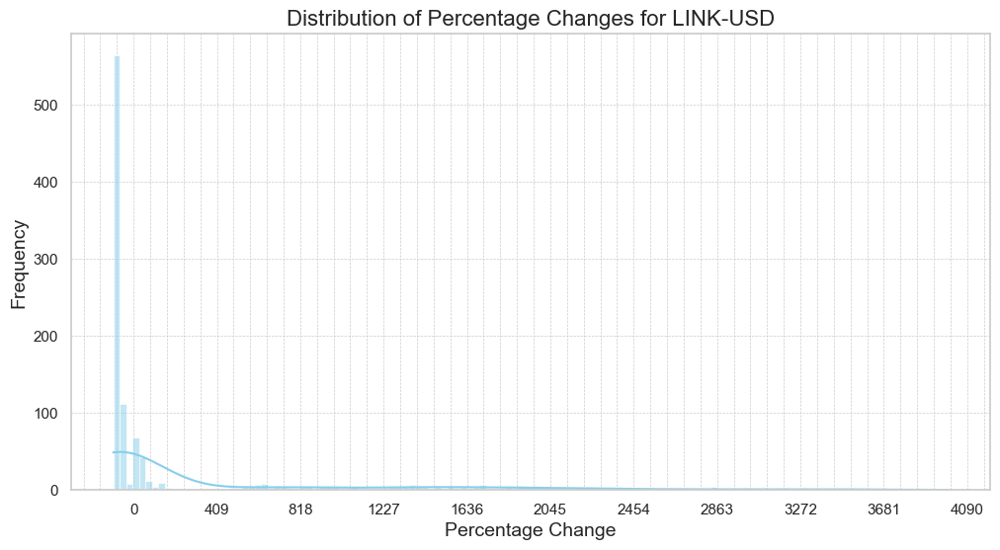

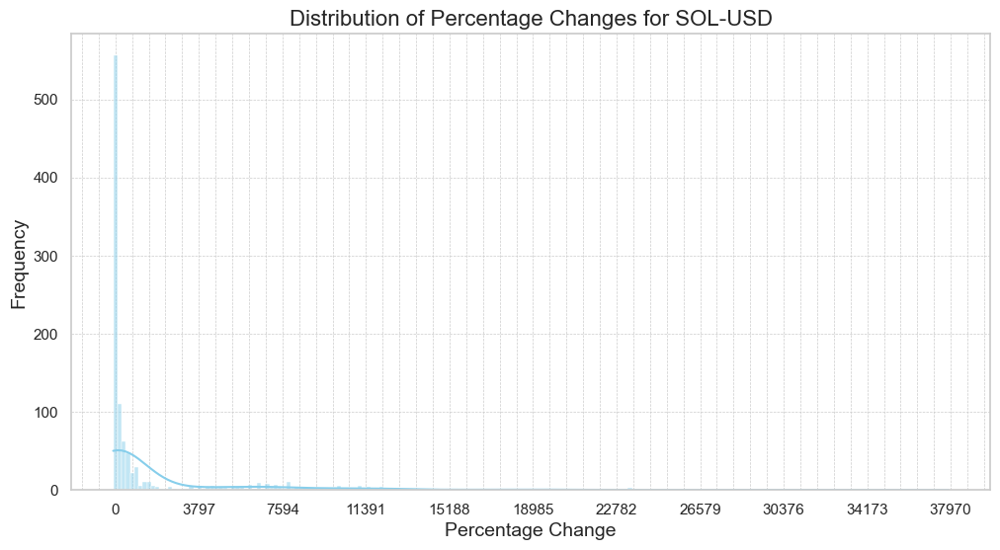

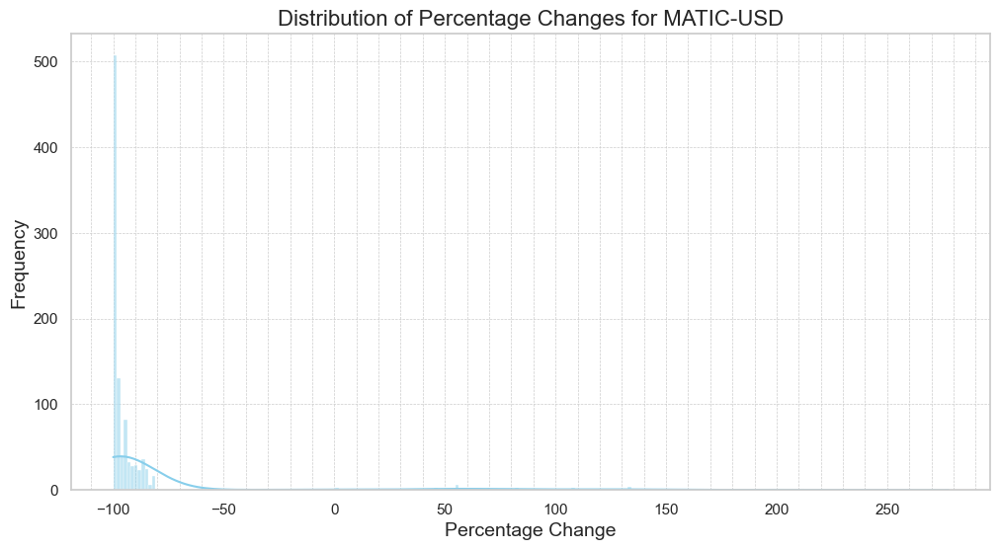

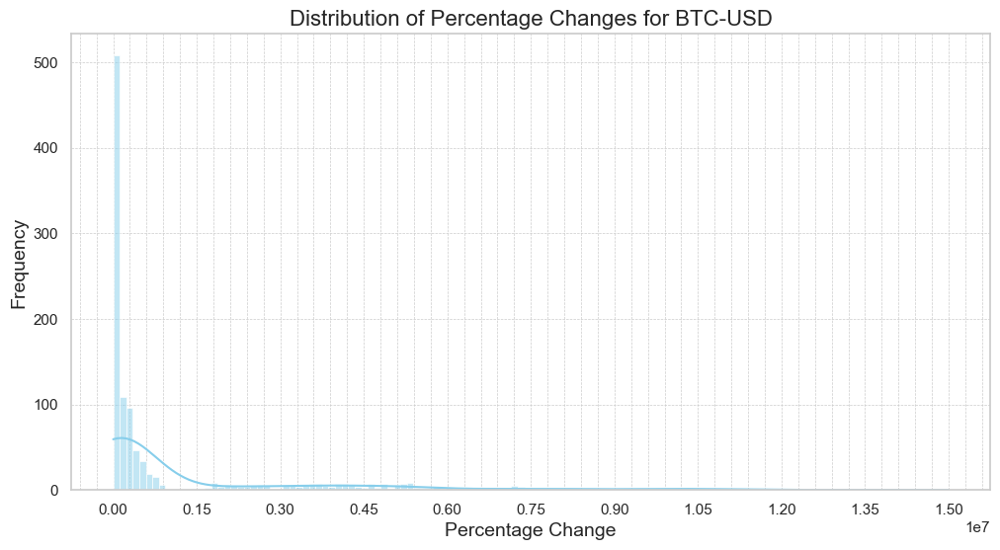

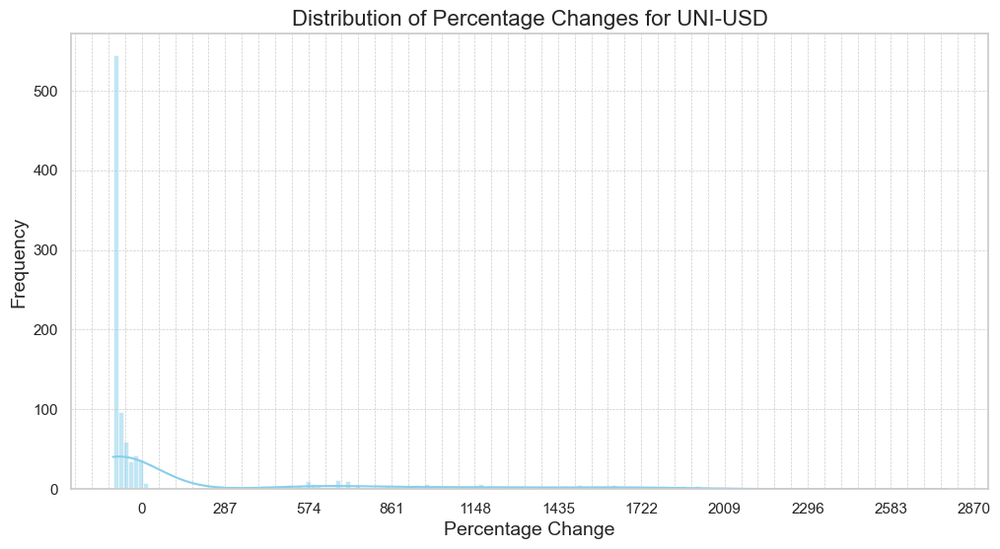

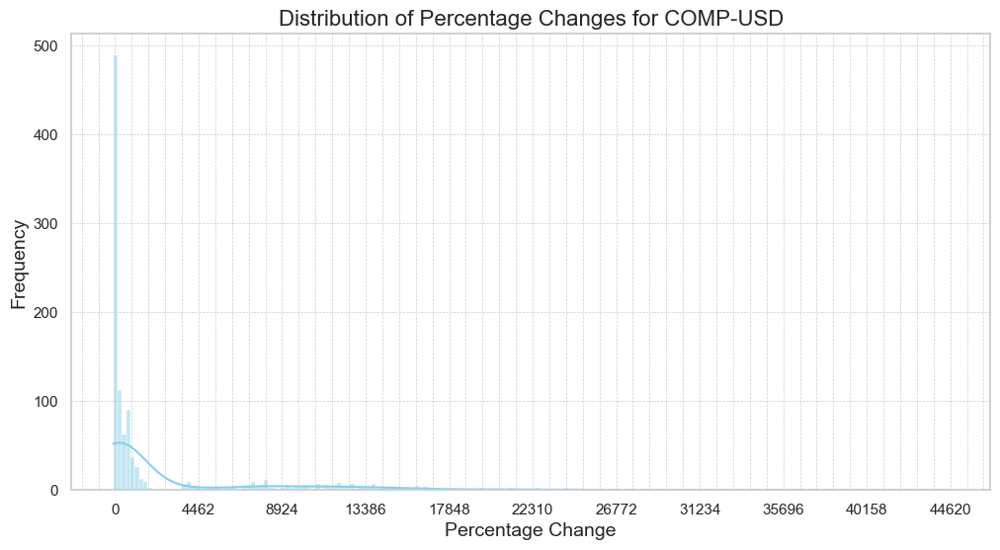

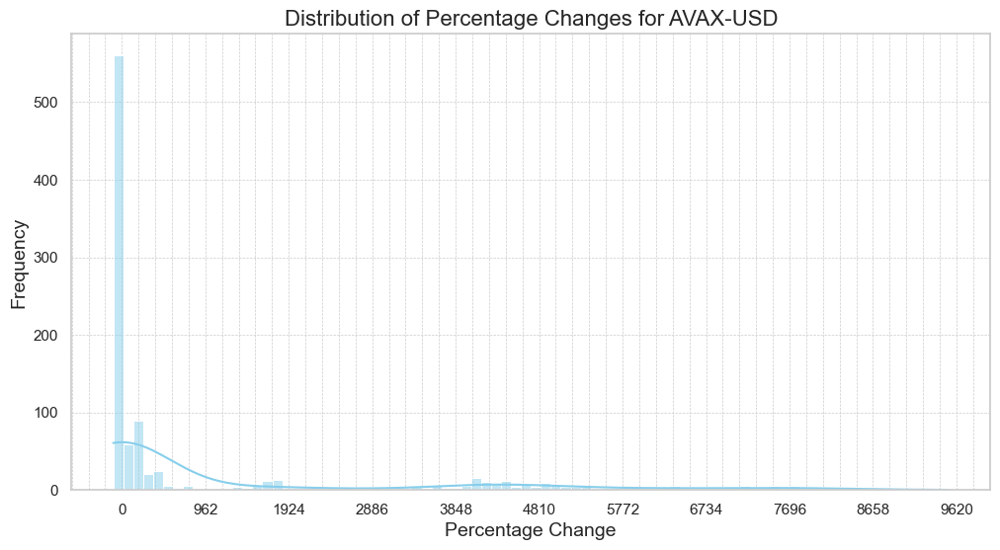

In [77]:
# Setting the style
sns.set(style="whitegrid")

# Distribution of percentage changes per cryptocurrency
for coin in df['product_id'].unique():
    plt.figure(figsize=(12, 6))
    ax = sns.histplot(df[df['product_id'] == coin]['pct_change'], kde=True, color='skyblue')
    
    # Formatting the plot
    ax.set_title(f'Distribution of Percentage Changes for {coin}', fontsize=16)
    ax.set_xlabel('Percentage Change', fontsize=14)
    ax.set_ylabel('Frequency', fontsize=14)
    
    # Handling extreme values by setting custom ticks based on data range
    pct_range = df[df['product_id'] == coin]['pct_change'].max() - df[df['product_id'] == coin]['pct_change'].min()
    if pct_range > 1000:
        major_tick = int(pct_range / 10)  # reduce number of major ticks for wide ranges
    else:
        major_tick = 50  # default tick setting for closer ranges
    
    ax.xaxis.set_major_locator(ticker.MultipleLocator(major_tick))
    ax.xaxis.set_minor_locator(ticker.MultipleLocator(major_tick / 5))  # smaller increments
    ax.xaxis.set_major_formatter(ticker.ScalarFormatter())

    # Add grid for better readability
    ax.grid(True, which='both', linestyle='--', linewidth=0.5)
    
    plt.show()


### Time Series of Percentage Change and Moving Average for Each Cryptocurrency

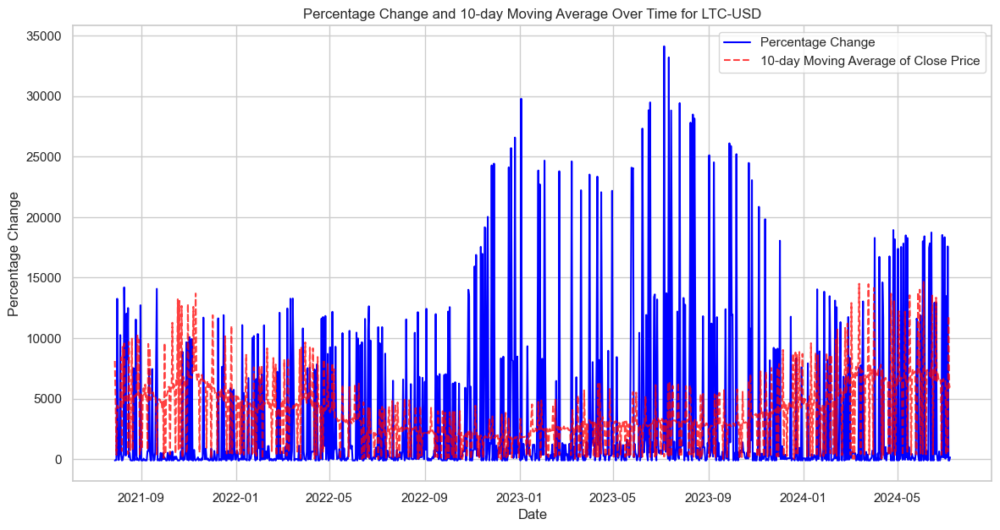

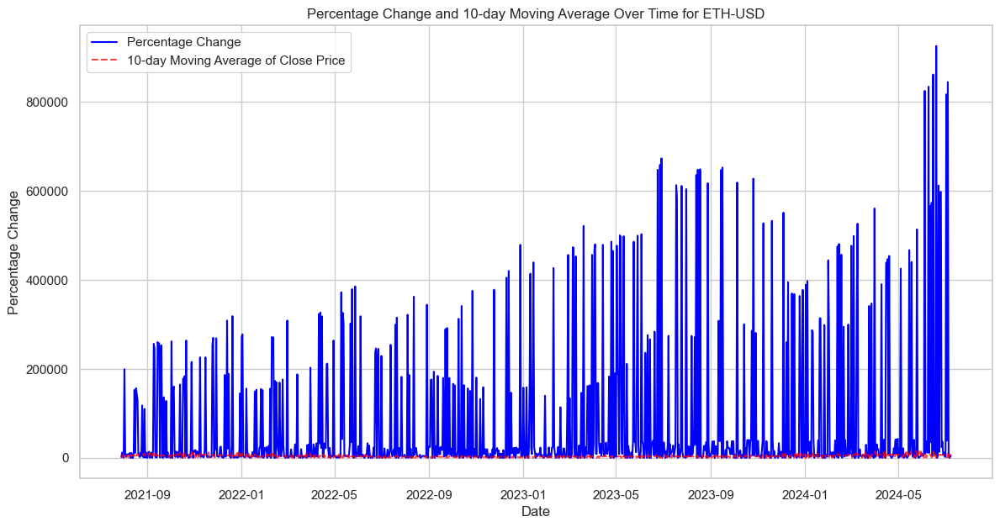

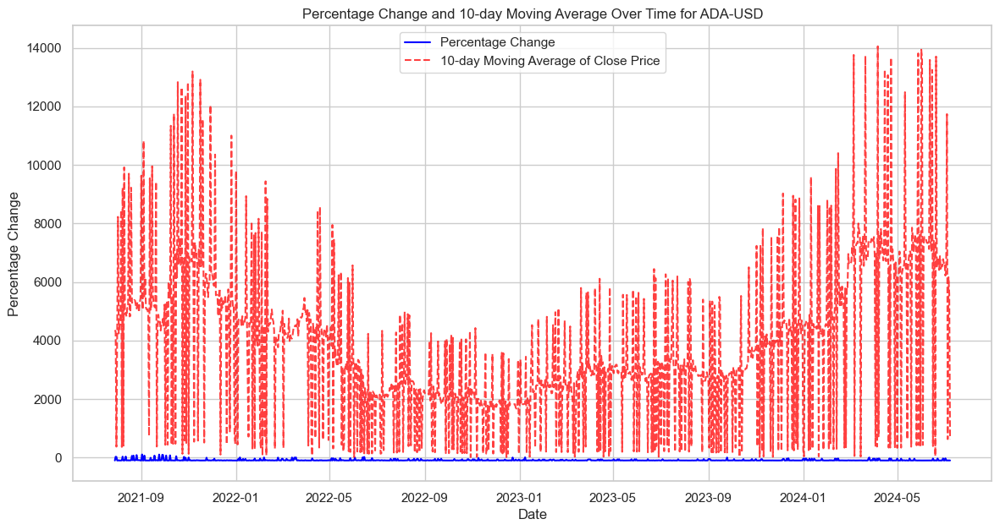

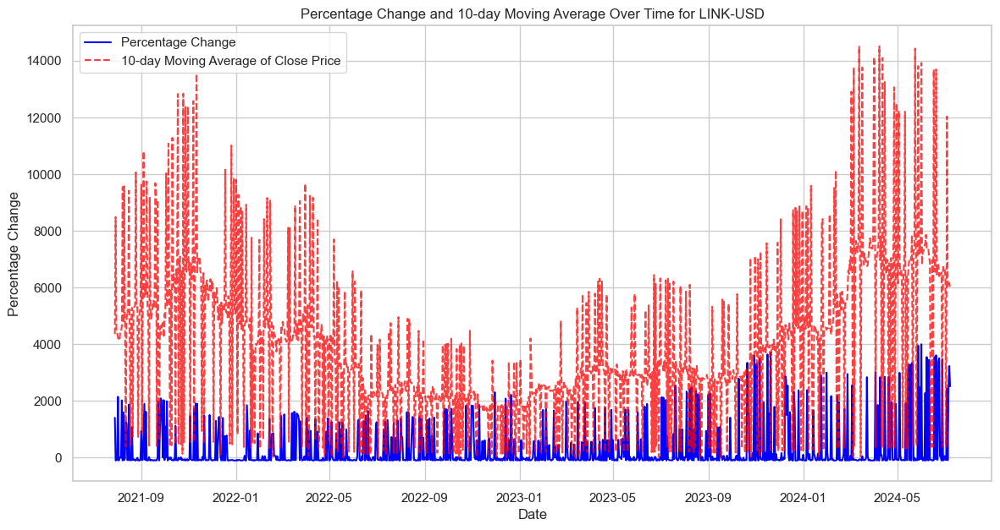

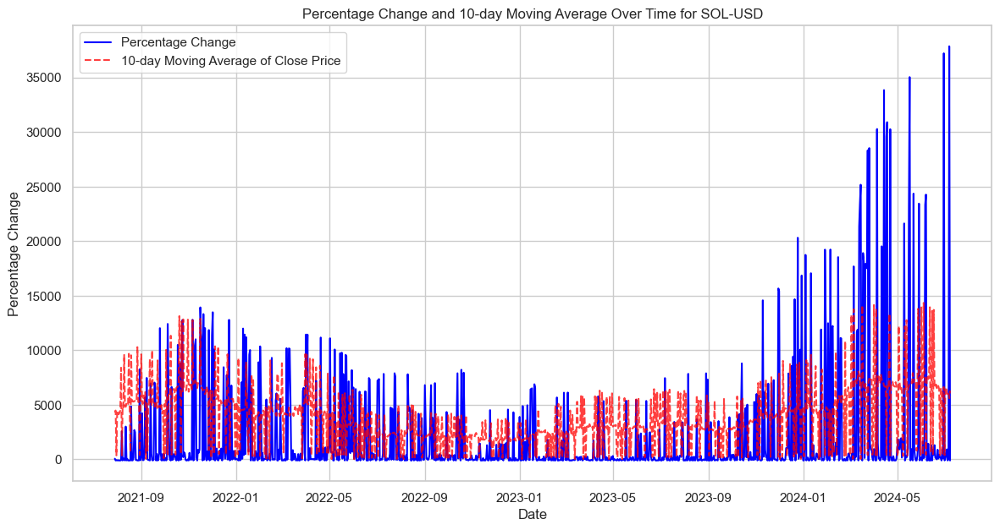

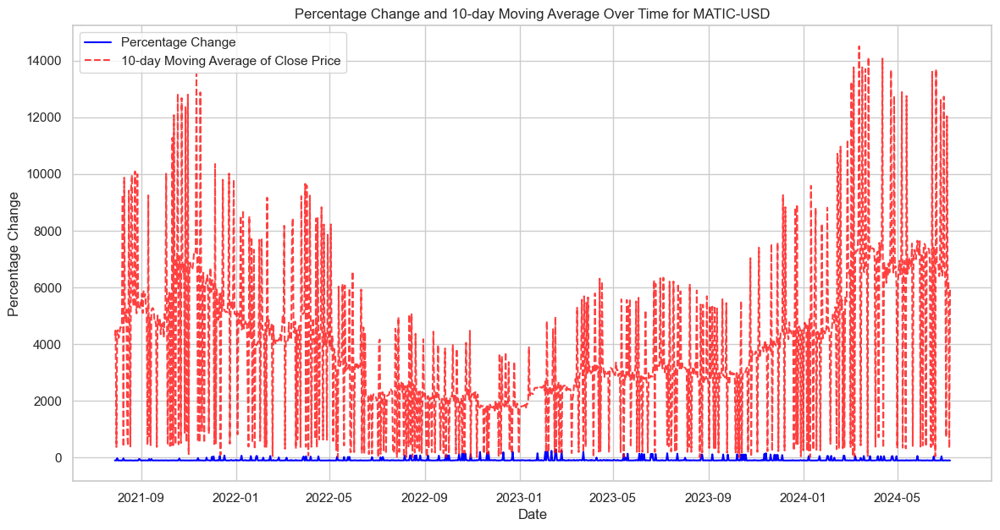

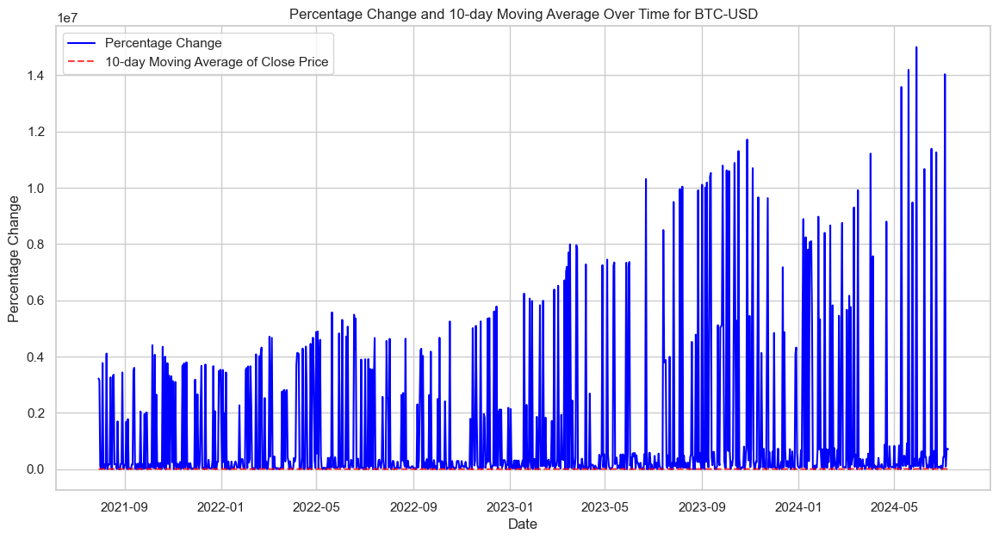

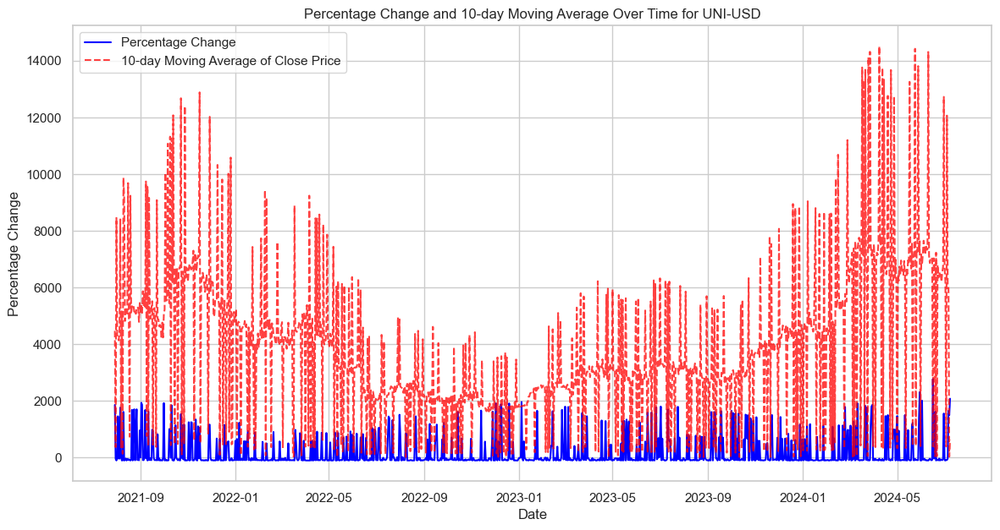

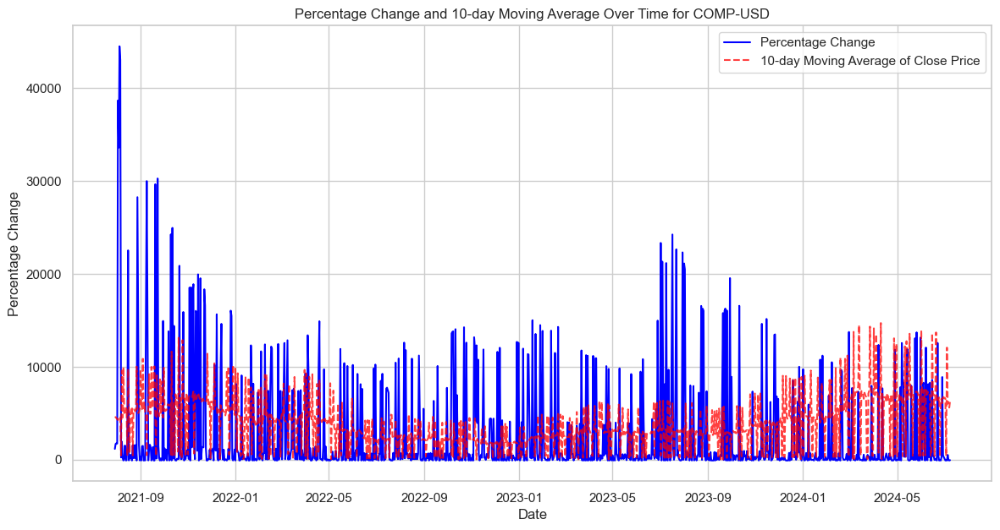

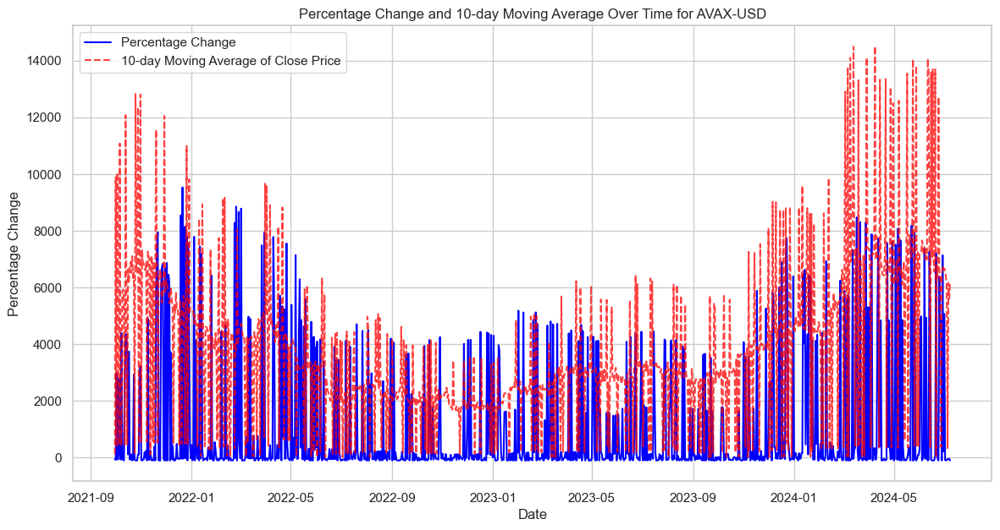

In [79]:
# Time Series of Percentage Change and Moving Average per cryptocurrency
for coin in df['product_id'].unique():
    plt.figure(figsize=(14, 7))
    coin_data = df[df['product_id'] == coin]
    plt.plot(coin_data.index, coin_data['pct_change'], label='Percentage Change', color='blue')
    plt.plot(coin_data.index, coin_data['close_MA10'], label='10-day Moving Average of Close Price', alpha=0.75, linestyle='--', color='red')
    plt.title(f'Percentage Change and 10-day Moving Average Over Time for {coin}')
    plt.xlabel('Date')
    plt.ylabel('Percentage Change')
    plt.legend()
    plt.show()

### Time Series of Percentage Changes and Moving Average for Each Cryptocurrency

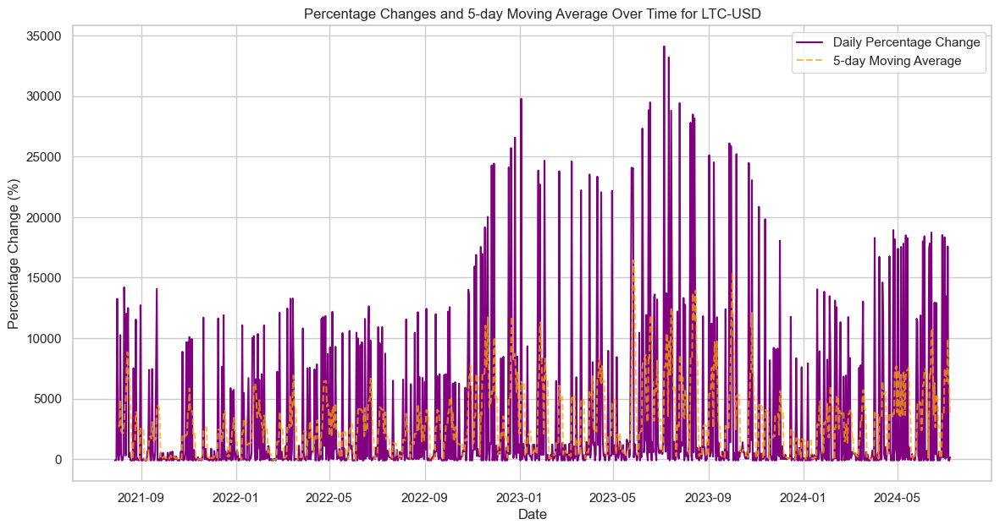

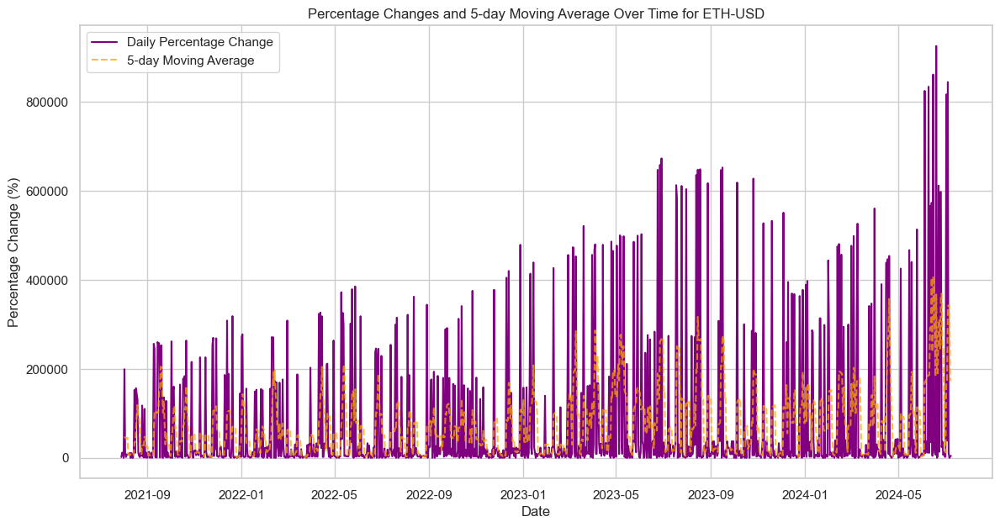

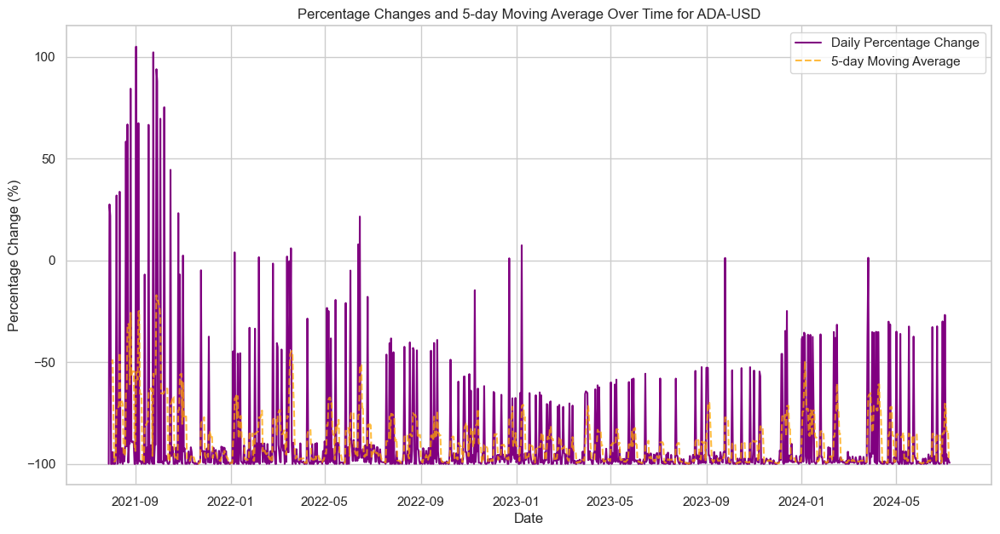

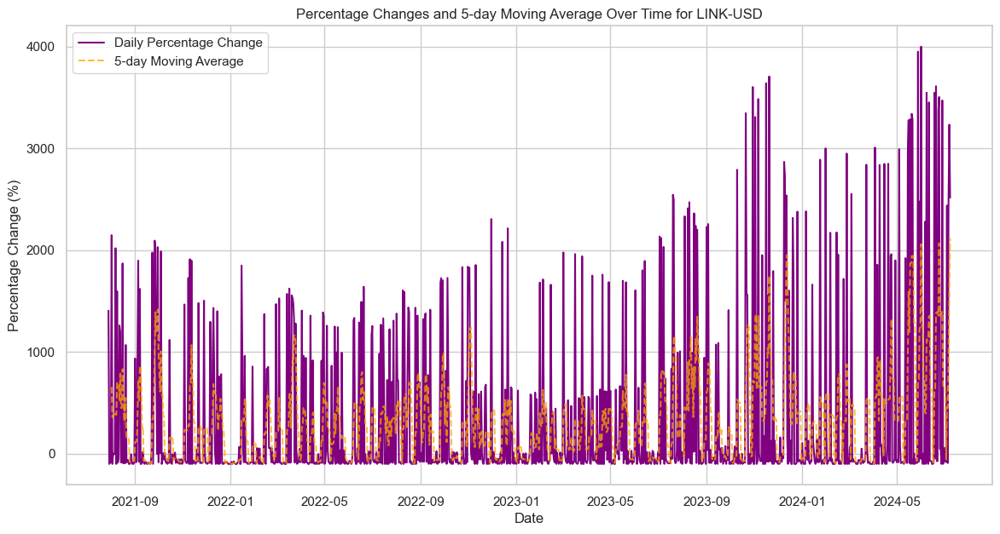

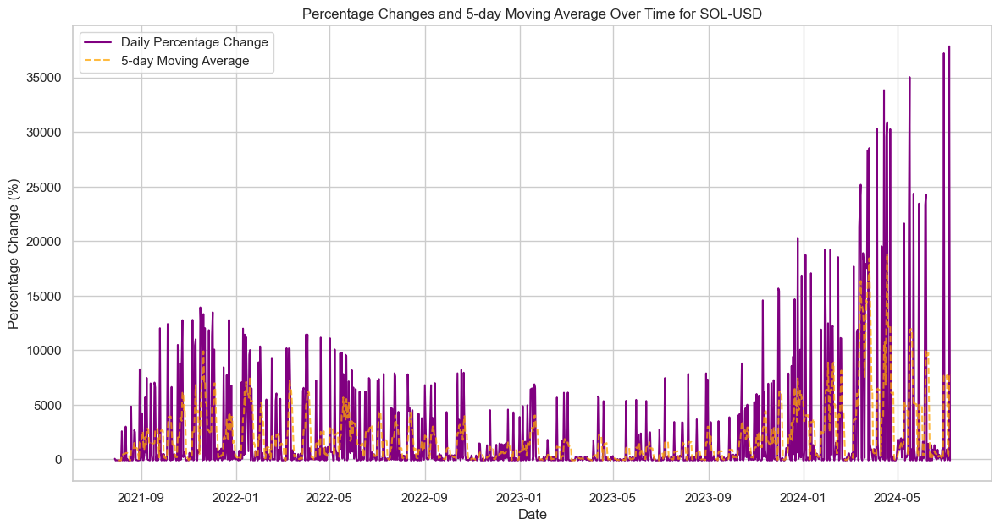

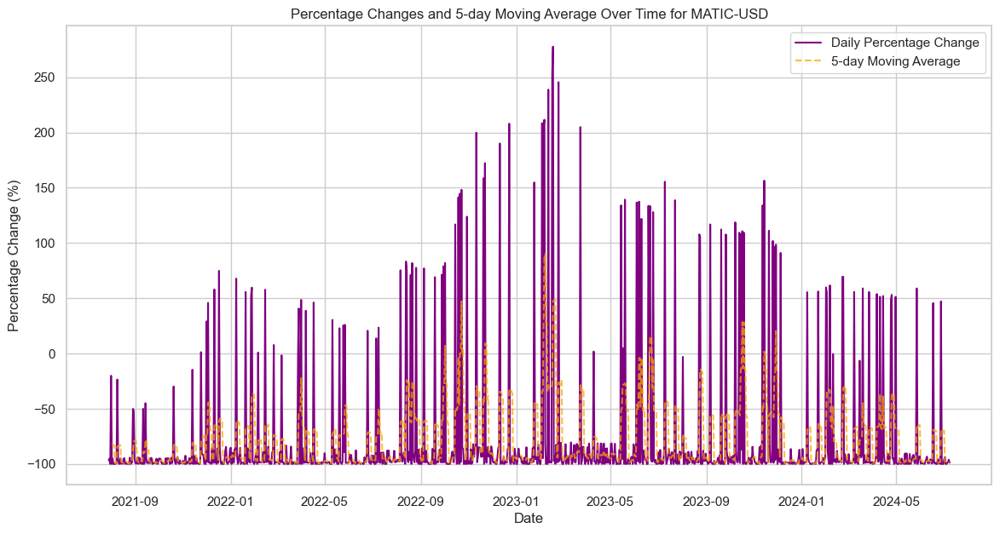

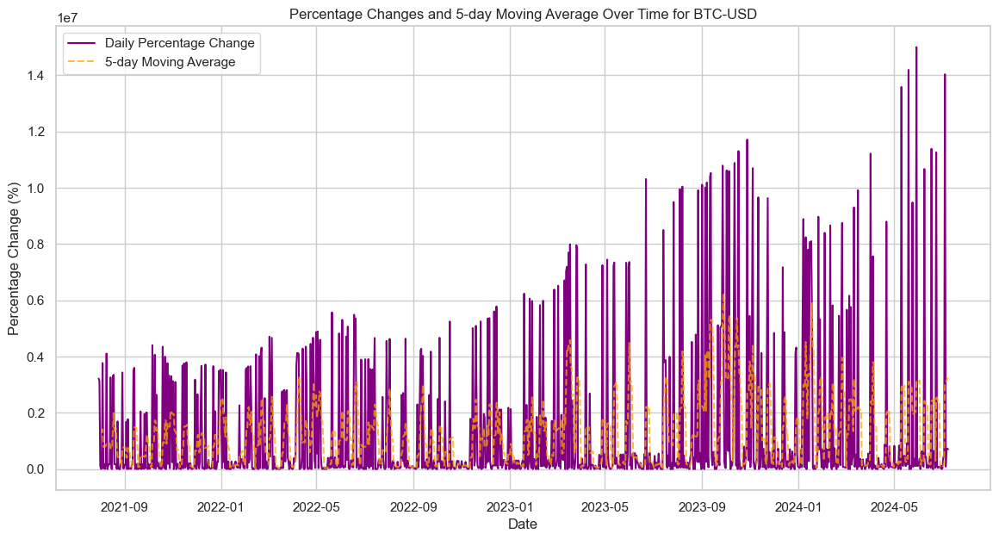

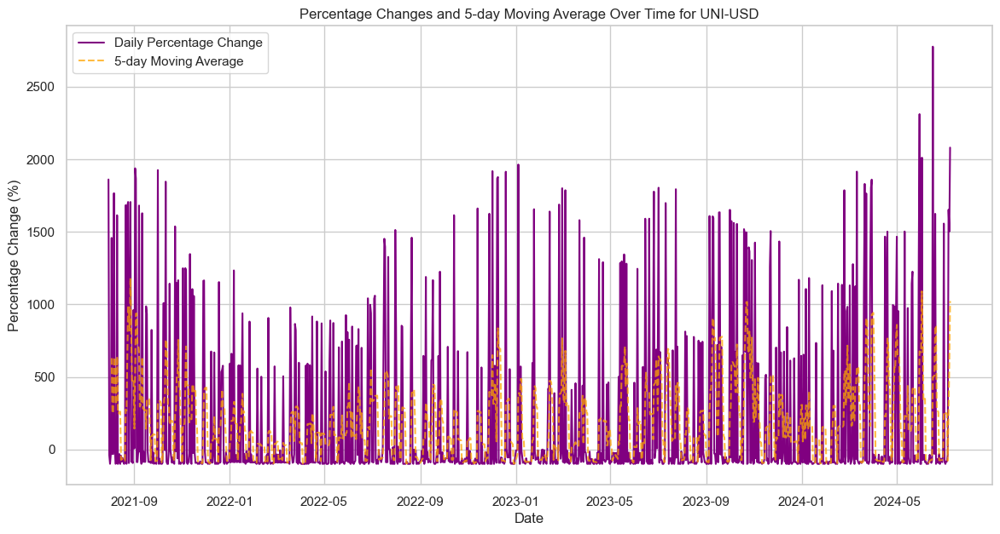

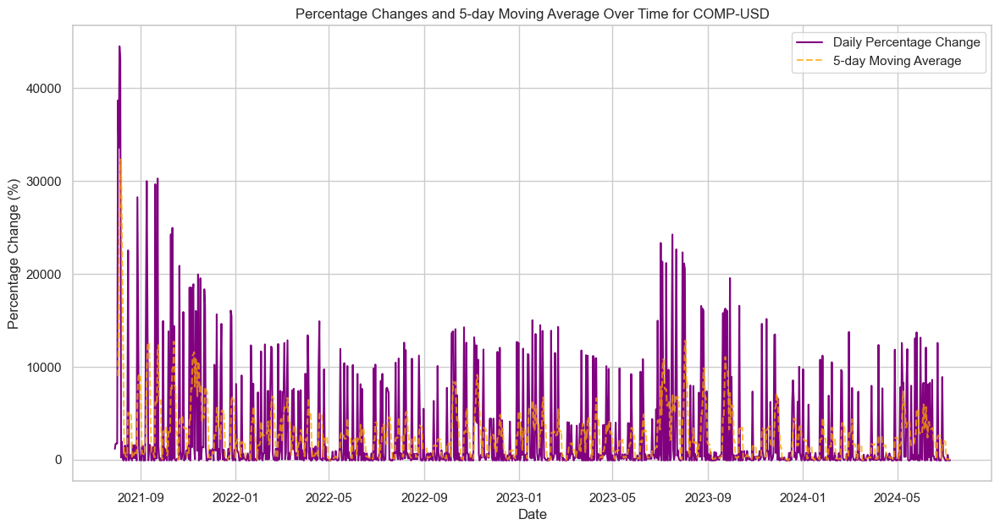

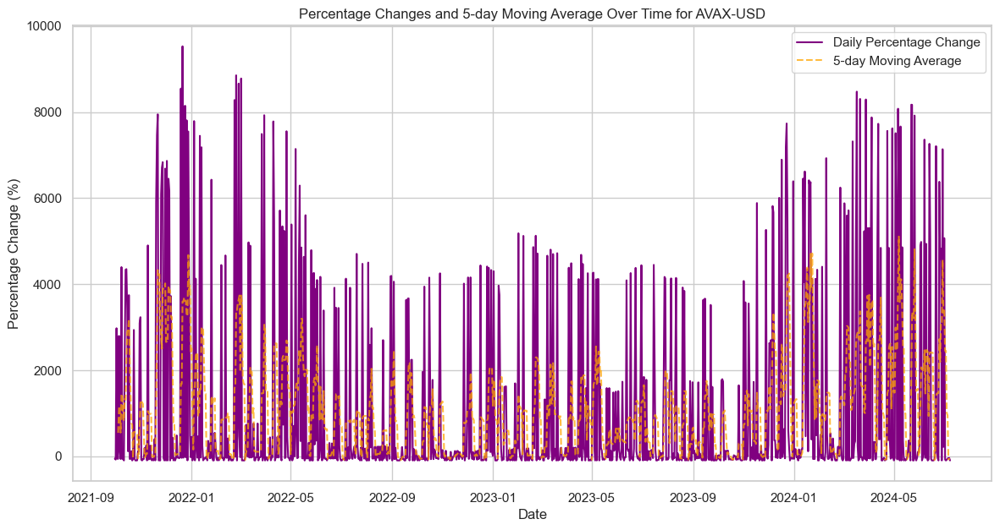

In [81]:
# Time Series of Percentage Changes and Moving Average per cryptocurrency
for coin in df['product_id'].unique():
    plt.figure(figsize=(14, 7))
    coin_data = df[df['product_id'] == coin].copy()  # Work on a copy to avoid SettingWithCopyWarning
    # Calculate a moving average for percentage changes
    coin_data['pct_change_MA5'] = coin_data['pct_change'].rolling(window=5).mean()

    plt.plot(coin_data.index, coin_data['pct_change'], label='Daily Percentage Change', color='purple')
    plt.plot(coin_data.index, coin_data['pct_change_MA5'], label='5-day Moving Average', alpha=0.75, linestyle='--', color='orange')
    plt.title(f'Percentage Changes and 5-day Moving Average Over Time for {coin}')
    plt.xlabel('Date')
    plt.ylabel('Percentage Change (%)')
    plt.legend()
    plt.grid(True)  # Adding grid for better readability
    plt.show()


### Correlation Matrix of Numeric Features for Each Cryptocurrency

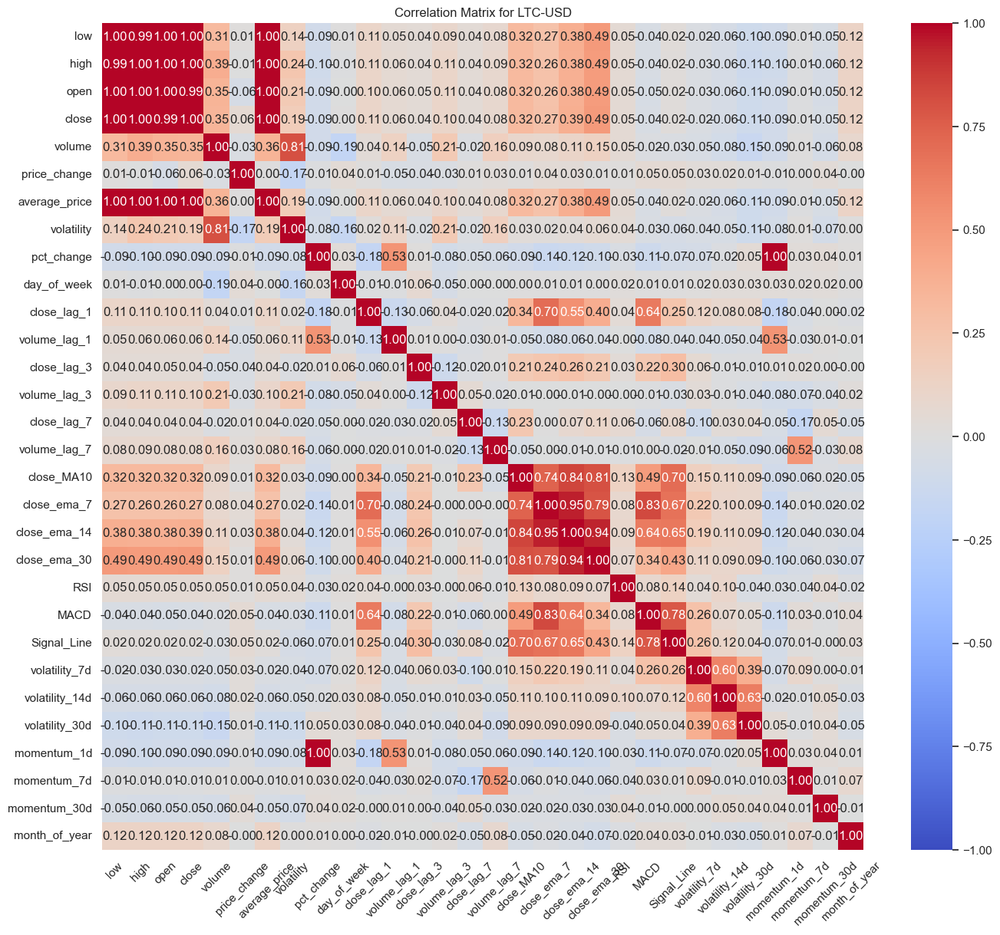

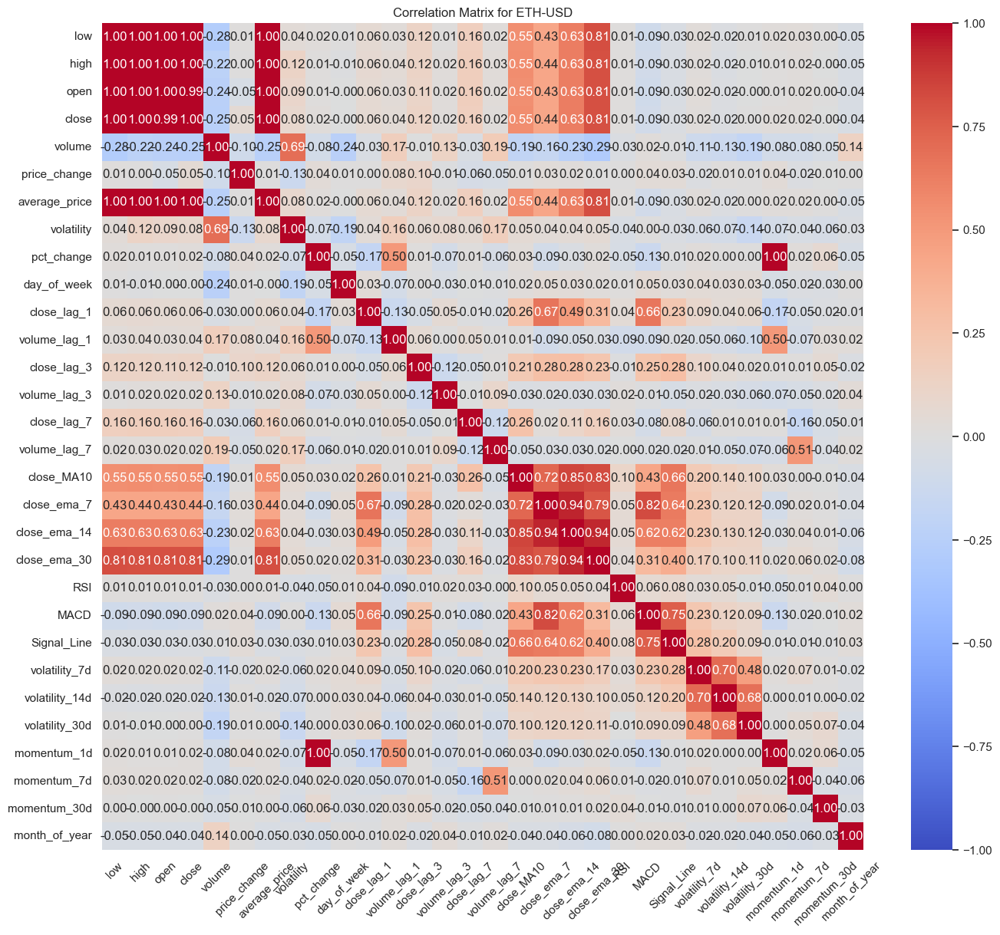

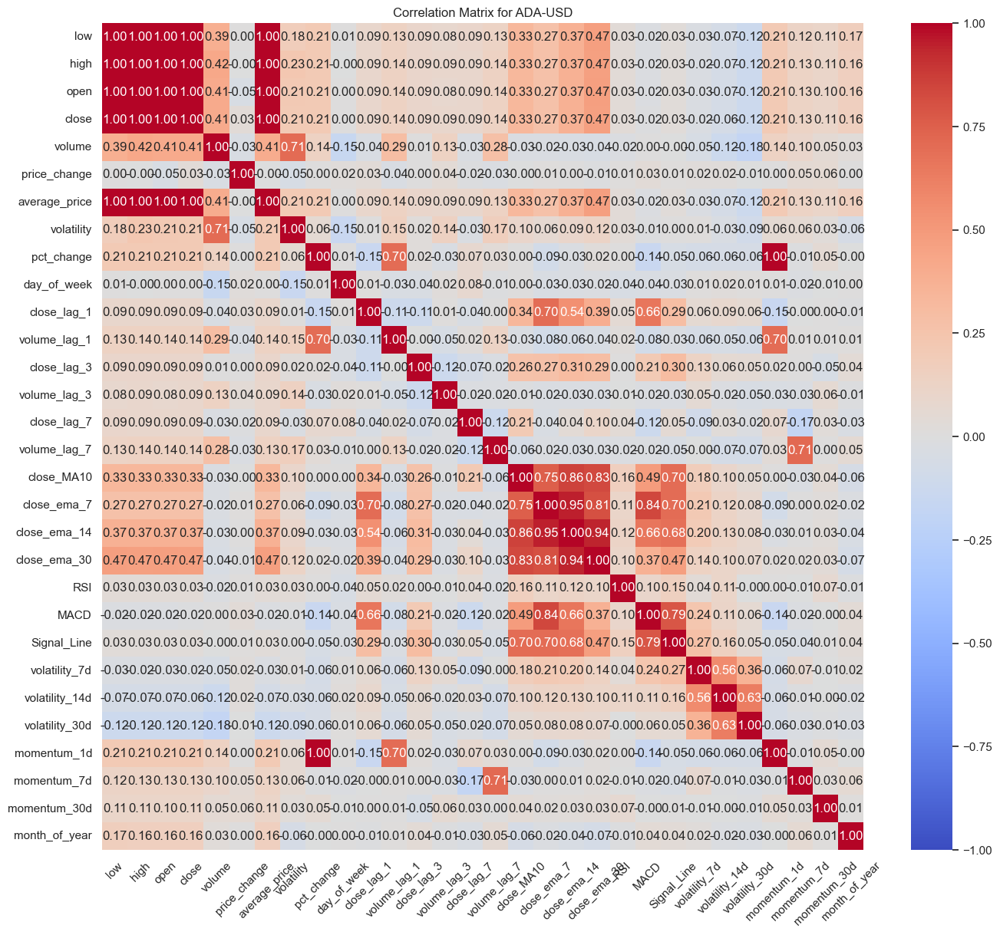

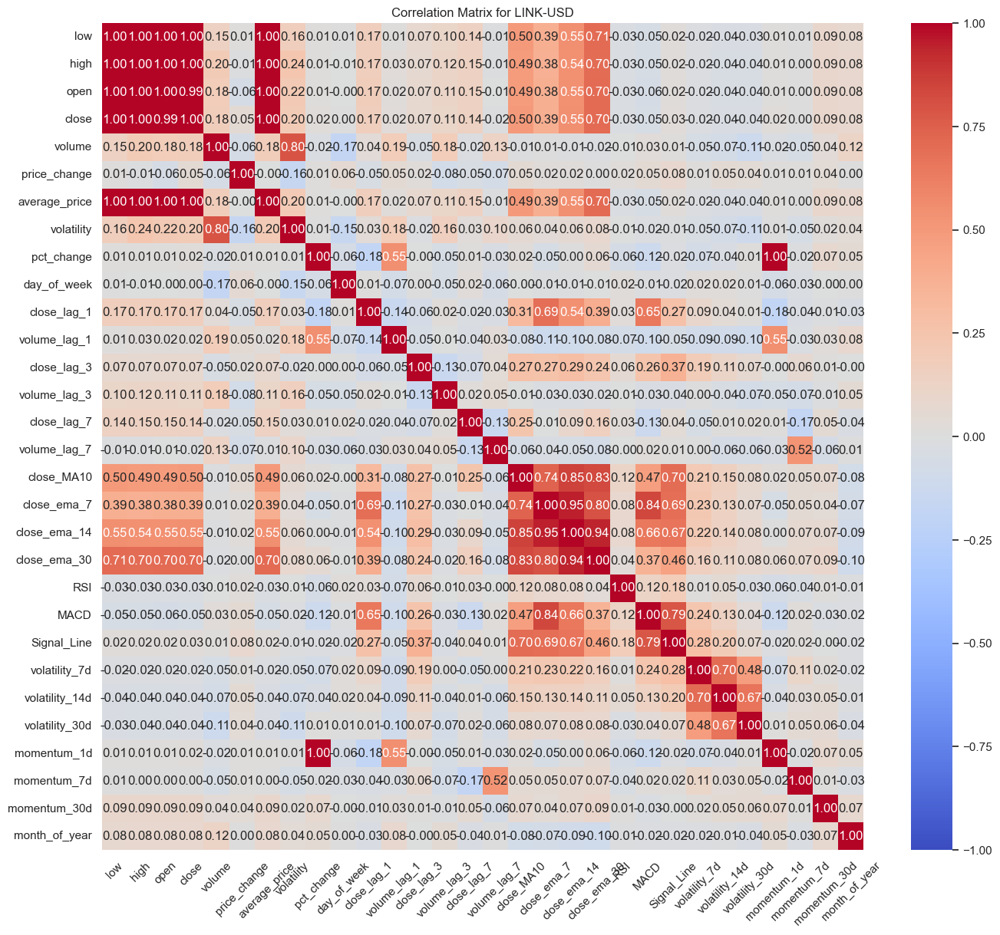

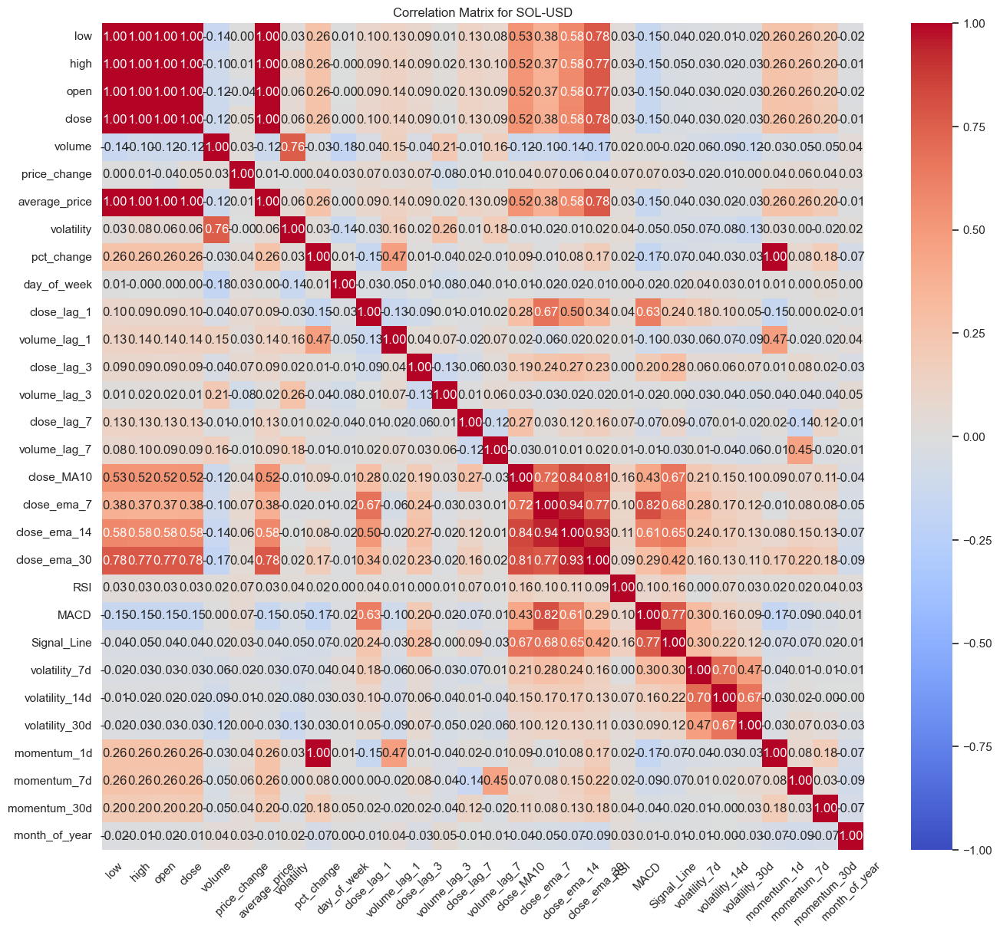

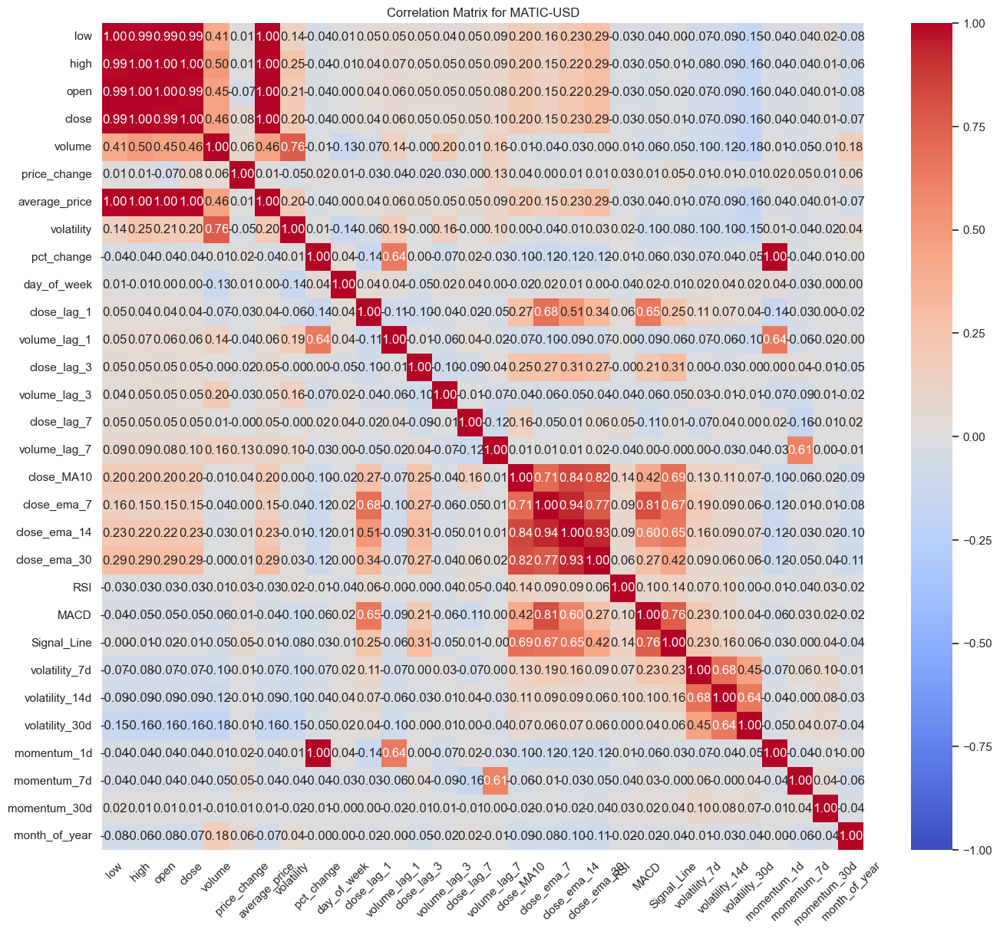

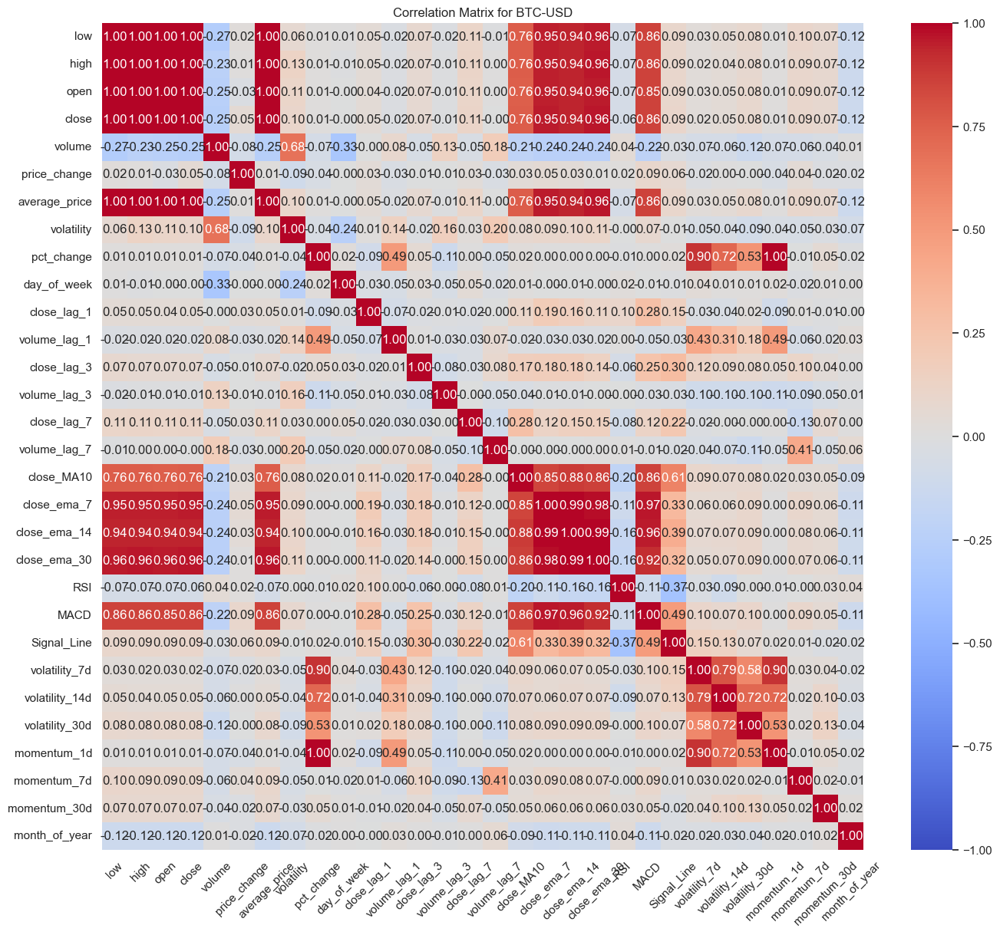

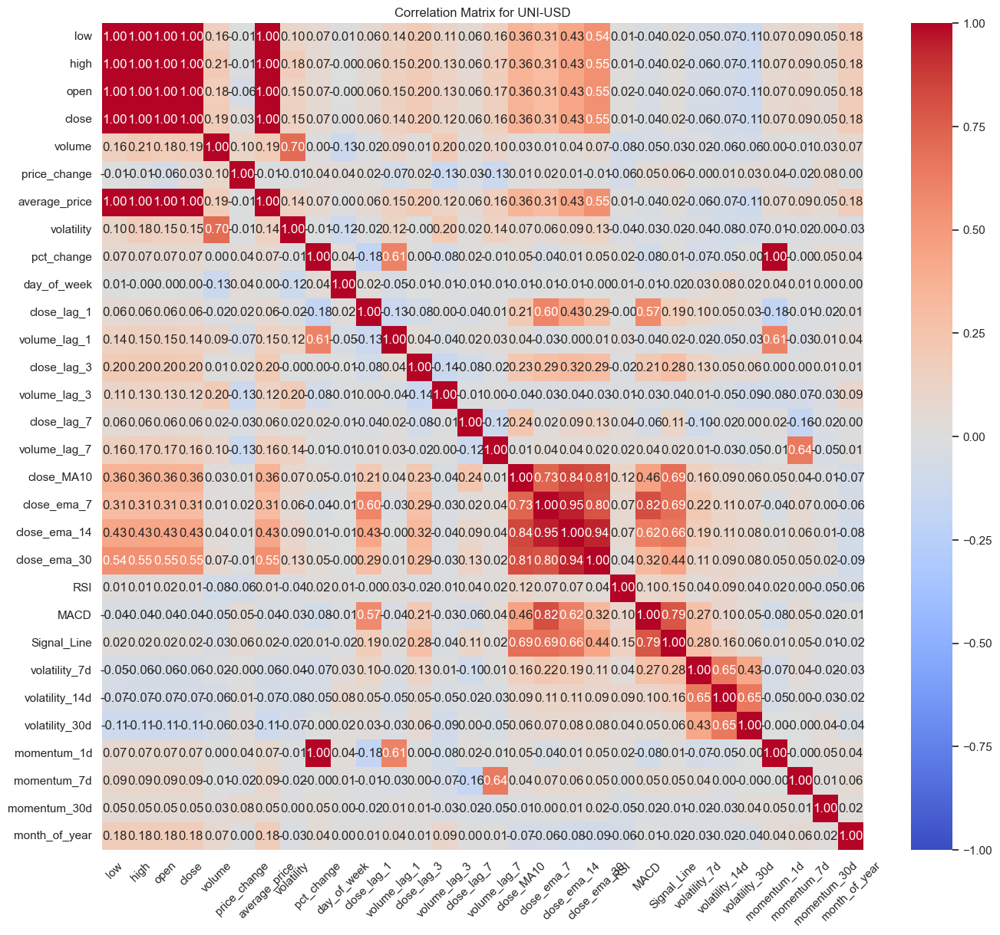

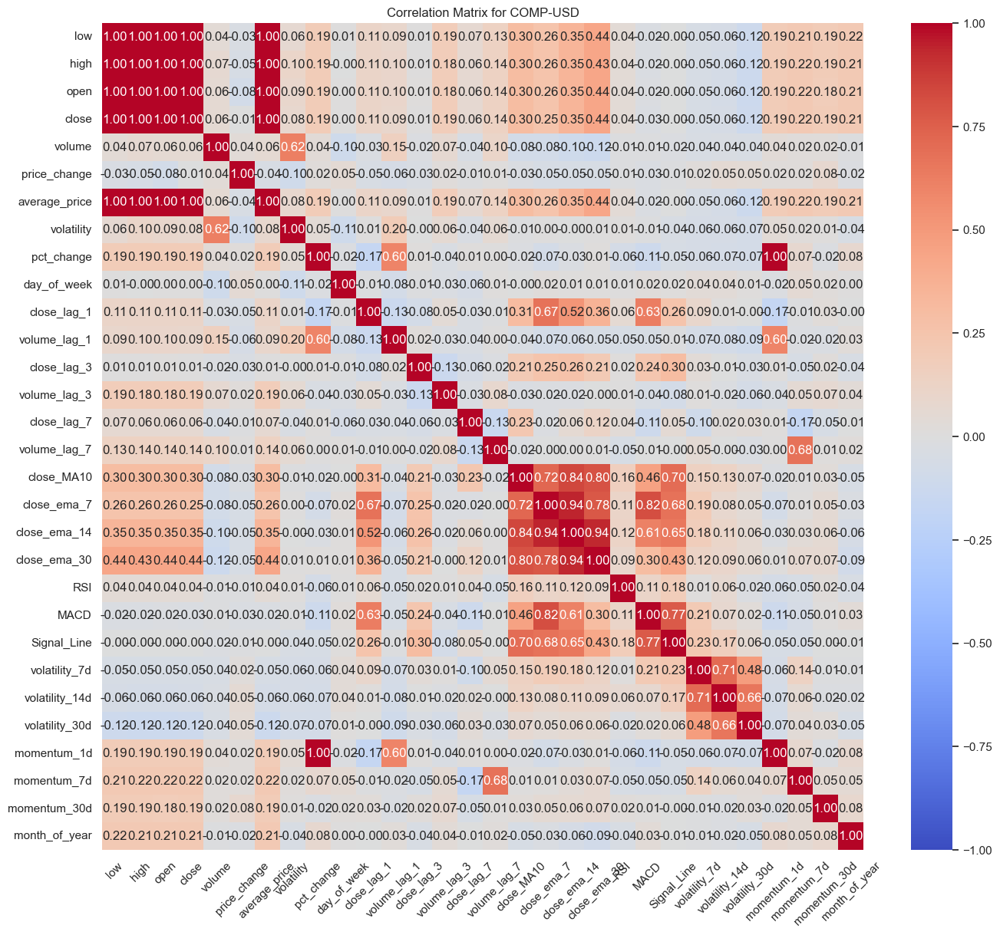

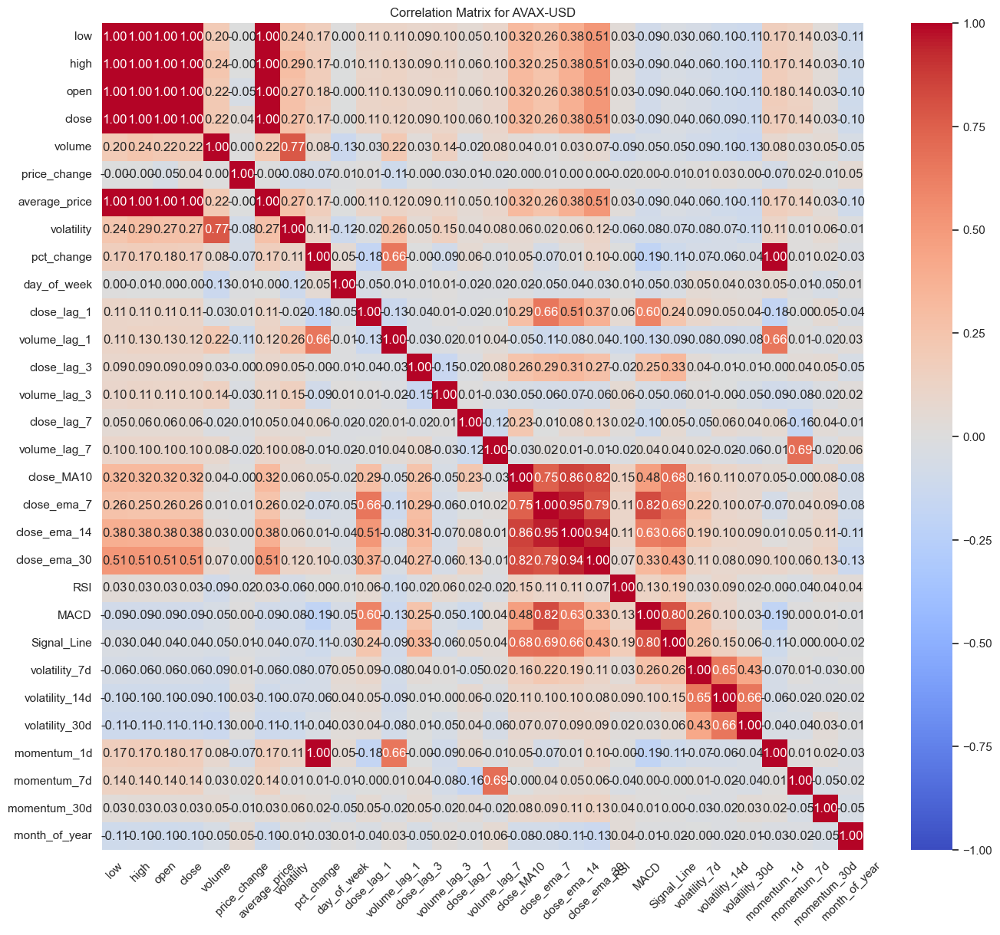

In [84]:
# Correlation Matrix of Numeric Features per cryptocurrency
for coin in df['product_id'].unique():
    plt.figure(figsize=(16, 14))  # Further increased figure size for better clarity
    # Filter data for the current cryptocurrency and select numeric types
    coin_data = df[df['product_id'] == coin].select_dtypes(include=[np.number])
    # Generate a heatmap
    sns.heatmap(coin_data.corr(), annot=True, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1)
    plt.title(f'Correlation Matrix for {coin}')
    plt.xticks(rotation=45)  # Rotate column names for better visibility
    plt.yticks(rotation=0)
    plt.show()


In [85]:
# Dictionary to hold correlation matrices
correlation_matrices = {}

# Calculate and store correlation matrices for each cryptocurrency
for coin in df['product_id'].unique():
    # Filter data for the current cryptocurrency and select numeric types
    coin_data = df[df['product_id'] == coin].select_dtypes(include=[np.number])
    correlation_matrices[coin] = coin_data.corr()

# Option 1: Display each matrix as a DataFrame in Jupyter Notebook
for coin, matrix in correlation_matrices.items():
    print(f"Correlation Matrix for {coin}:")
    display(matrix)  # This uses IPython.display.display to show DataFrames nicely in Jupyter

# Option 2: Export each matrix to a CSV file
for coin, matrix in correlation_matrices.items():
    matrix.to_csv(f'correlation_matrix_{coin}.csv')


Correlation Matrix for LTC-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.994139,0.995122,0.997084,0.314480,0.014836,0.998385,0.144655,-0.089242,0.007485,0.105920,0.052693,0.044168,0.092972,0.043135,0.076560,0.319841,0.265409,0.384713,0.493273,0.050949,-0.043543,0.023730,-0.024011,-0.056149,-0.104384,-0.089242,-0.009552,-0.050586,0.117896
high,0.994139,1.000000,0.996558,0.995968,0.392931,-0.006726,0.998675,0.239958,-0.095126,-0.008416,0.107175,0.059572,0.043130,0.107668,0.039218,0.085774,0.318607,0.264014,0.381861,0.490380,0.051760,-0.044227,0.018612,-0.025383,-0.058919,-0.110094,-0.095126,-0.008471,-0.055308,0.121865
open,0.995122,0.996558,1.000000,0.993002,0.354161,-0.060895,0.997335,0.207252,-0.092141,-0.002730,0.104941,0.061033,0.046107,0.105682,0.040785,0.079967,0.317948,0.261511,0.381247,0.491756,0.049747,-0.049082,0.016399,-0.028349,-0.059587,-0.108146,-0.092141,-0.010722,-0.054880,0.118289
close,0.997084,0.995968,0.993002,1.000000,0.350744,0.057411,0.997958,0.186655,-0.093478,0.002133,0.105832,0.055555,0.041625,0.102025,0.042038,0.082966,0.319395,0.266476,0.385126,0.493495,0.051253,-0.042622,0.022522,-0.024856,-0.056655,-0.107551,-0.093478,-0.010239,-0.050706,0.118188
volume,0.314480,0.392931,0.354161,0.350744,1.000000,-0.029497,0.356167,0.806086,-0.093660,-0.185162,0.037887,0.135267,-0.046767,0.209824,-0.021513,0.163380,0.087933,0.079319,0.110541,0.147617,0.052049,-0.021611,-0.027214,-0.045743,-0.081310,-0.146245,-0.093660,0.006108,-0.063913,0.082923
price_change,0.014836,-0.006726,-0.060895,0.057411,-0.029497,1.000000,0.003526,-0.174450,-0.011143,0.041105,0.007341,-0.046408,-0.037958,-0.031093,0.010524,0.025202,0.011673,0.041509,0.032119,0.013836,0.012636,0.054687,0.051719,0.029578,0.024880,0.005217,-0.011143,0.004100,0.035371,-0.001059
average_price,0.998385,0.998675,0.997335,0.997958,0.356167,0.003526,1.000000,0.194949,-0.092465,-0.000860,0.106735,0.056385,0.043687,0.100831,0.041140,0.081514,0.319661,0.265065,0.383778,0.492475,0.051450,-0.043966,0.021075,-0.024767,-0.057687,-0.107538,-0.092465,-0.008998,-0.053142,0.120154
volatility,0.144655,0.239958,0.207252,0.186655,0.806086,-0.174450,0.194949,1.000000,-0.076938,-0.157956,0.017641,0.113574,-0.021863,0.205476,-0.023286,0.162669,0.031177,0.023288,0.036202,0.061866,0.044212,-0.032033,-0.055114,-0.039766,-0.050589,-0.107914,-0.076938,0.012789,-0.070815,0.003362
pct_change,-0.089242,-0.095126,-0.092141,-0.093478,-0.093660,-0.011143,-0.092465,-0.076938,1.000000,0.027141,-0.177383,0.528910,0.013680,-0.081877,-0.047307,-0.064294,-0.091360,-0.137879,-0.122989,-0.100642,-0.032483,-0.114389,-0.073480,-0.067163,-0.018722,0.046165,1.000000,0.026130,0.038952,0.008887
day_of_week,0.007485,-0.008416,-0.002730,0.002133,-0.185162,0.041105,-0.000860,-0.157956,0.027141,1.000000,-0.007906,-0.012696,0.062776,-0.054949,-0.003834,-0.003193,0.001911,0.005055,0.005616,0.004418,0.017324,0.005875,0.007674,0.015078,0.026389,0.030995,0.027141,0.017163,0.024544,0.004842


Correlation Matrix for ETH-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.995963,0.996318,0.997349,-0.275827,0.013258,0.998924,0.037222,0.020913,0.007804,0.059240,0.030088,0.117656,0.013087,0.159418,0.015868,0.553796,0.433825,0.627350,0.812586,0.011620,-0.093993,-0.031959,0.024285,-0.018795,0.006145,0.020913,0.025285,0.003444,-0.045878
high,0.995963,1.000000,0.997965,0.997636,-0.221023,0.000042,0.999054,0.119626,0.013450,-0.009650,0.063748,0.043291,0.122560,0.018576,0.164342,0.027180,0.554939,0.435314,0.627341,0.811683,0.008483,-0.091537,-0.032966,0.019765,-0.023735,-0.005003,0.013450,0.018855,-0.002979,-0.045544
open,0.996318,0.997965,1.000000,0.994709,-0.238390,-0.048199,0.998175,0.094212,0.014066,-0.002556,0.061579,0.031936,0.114624,0.017308,0.164823,0.024718,0.554326,0.433629,0.626660,0.812030,0.008588,-0.094352,-0.034144,0.023466,-0.021680,-0.000508,0.014066,0.021811,0.000614,-0.044730
close,0.997349,0.997636,0.994709,1.000000,-0.248250,0.054669,0.998505,0.080869,0.017867,-0.001978,0.061922,0.040610,0.124762,0.015802,0.158495,0.019319,0.554884,0.436100,0.628379,0.812414,0.008823,-0.090540,-0.030729,0.021352,-0.020390,0.000020,0.017867,0.019771,-0.000096,-0.044587
volume,-0.275827,-0.221023,-0.238390,-0.248250,1.000000,-0.096641,-0.247792,0.693804,-0.084752,-0.239156,-0.033436,0.168108,-0.005517,0.131622,-0.034726,0.188047,-0.188382,-0.159599,-0.229254,-0.290141,-0.028555,0.022359,-0.012022,-0.109762,-0.125245,-0.187354,-0.084752,-0.080942,-0.049916,0.135848
price_change,0.013258,0.000042,-0.048199,0.054669,-0.096641,1.000000,0.006444,-0.129422,0.037006,0.005611,0.003531,0.084441,0.098937,-0.014587,-0.060993,-0.052411,0.007219,0.025438,0.018746,0.006368,0.002315,0.036755,0.033087,-0.020480,0.012474,0.005131,0.037006,-0.019759,-0.006900,0.001247
average_price,0.998924,0.999054,0.998175,0.998505,-0.247792,0.006444,1.000000,0.079831,0.017079,-0.001205,0.061629,0.036939,0.120308,0.015936,0.162123,0.021728,0.554945,0.435032,0.627978,0.812940,0.010011,-0.092819,-0.032512,0.021974,-0.021366,0.000392,0.017079,0.021988,0.000129,-0.045752
volatility,0.037222,0.119626,0.094212,0.080869,0.693804,-0.129422,0.079831,1.000000,-0.074092,-0.189173,0.038603,0.164073,0.056136,0.077733,0.058824,0.168750,0.050210,0.038415,0.042608,0.054285,-0.042208,0.001081,-0.025668,-0.059812,-0.073807,-0.141925,-0.074092,-0.044069,-0.055690,-0.025124
pct_change,0.020913,0.013450,0.014066,0.017867,-0.084752,0.037006,0.017079,-0.074092,1.000000,-0.050505,-0.173638,0.500916,0.013237,-0.070949,0.011534,-0.059740,0.027104,-0.085218,-0.027595,0.018604,-0.050530,-0.125872,-0.010383,0.015625,0.004511,0.004090,1.000000,0.017882,0.063973,-0.047383
day_of_week,0.007804,-0.009650,-0.002556,-0.001978,-0.239156,0.005611,-0.001205,-0.189173,-0.050505,1.000000,0.034958,-0.071230,0.001844,-0.034340,-0.006282,-0.007871,0.018348,0.045303,0.033920,0.019490,0.010735,0.050891,0.029731,0.039868,0.031944,0.031548,-0.050505,-0.023135,-0.027440,0.004842


Correlation Matrix for ADA-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.997438,0.997608,0.998225,0.385197,0.001265,0.999303,0.177880,0.208713,0.006143,0.090037,0.133764,0.094174,0.083859,0.094916,0.128818,0.330696,0.269227,0.371357,0.469090,0.033062,-0.016144,0.029740,-0.026682,-0.065383,-0.120899,0.208713,0.124022,0.106939,0.165026
high,0.997438,1.000000,0.998469,0.998884,0.423866,-0.001302,0.999413,0.231939,0.207934,-0.002317,0.088509,0.138543,0.093859,0.088908,0.090526,0.140151,0.330371,0.268603,0.370513,0.468029,0.034951,-0.015985,0.029811,-0.024752,-0.065970,-0.122830,0.207934,0.128552,0.106293,0.162336
open,0.997608,0.998469,1.000000,0.996898,0.408728,-0.045950,0.998695,0.212888,0.207839,0.000320,0.087377,0.139004,0.094347,0.083890,0.093110,0.139337,0.330570,0.268039,0.370829,0.469208,0.033714,-0.017867,0.029136,-0.026289,-0.065867,-0.121447,0.207839,0.126399,0.103789,0.163223
close,0.998225,0.998884,0.996898,1.000000,0.406457,0.032811,0.999207,0.208843,0.208269,0.002065,0.089971,0.136259,0.094535,0.087348,0.091957,0.137286,0.330690,0.269286,0.371097,0.468460,0.034808,-0.015367,0.030224,-0.024725,-0.064668,-0.122042,0.208269,0.130526,0.108393,0.163414
volume,0.385197,0.423866,0.408728,0.406457,1.000000,-0.031512,0.405618,0.709821,0.140377,-0.152326,-0.038945,0.291375,0.005337,0.133631,-0.030399,0.279567,-0.026819,-0.023753,-0.032726,-0.041545,-0.023204,0.003429,-0.000671,-0.052410,-0.120702,-0.175978,0.140377,0.096834,0.048774,0.030818
price_change,0.001265,-0.001302,-0.045950,0.032811,-0.031512,1.000000,-0.000074,-0.052736,0.004093,0.022153,0.032354,-0.035755,0.001767,0.043346,-0.015237,-0.026948,-0.000654,0.014063,0.000966,-0.012576,0.013664,0.031842,0.013618,0.020019,0.015649,-0.006754,0.004093,0.051549,0.057761,0.001354
average_price,0.999303,0.999413,0.998695,0.999207,0.405618,-0.000074,1.000000,0.206198,0.208440,0.001733,0.089297,0.136343,0.094070,0.086547,0.092687,0.134813,0.330738,0.269074,0.371154,0.468837,0.034069,-0.016071,0.029796,-0.025692,-0.065731,-0.121984,0.208440,0.126464,0.106670,0.163728
volatility,0.177880,0.231939,0.212888,0.208843,0.709821,-0.052736,0.206198,1.000000,0.058396,-0.148198,0.005510,0.149214,0.020219,0.142826,-0.025063,0.169588,0.099760,0.063023,0.094210,0.124253,0.033136,-0.014997,0.004419,0.007959,-0.032244,-0.090836,0.058396,0.056237,0.030874,-0.060886
pct_change,0.208713,0.207934,0.207839,0.208269,0.140377,0.004093,0.208440,0.058396,1.000000,0.005383,-0.146272,0.700170,0.021834,-0.033343,0.072582,0.032217,0.003208,-0.085187,-0.029809,0.023357,0.001204,-0.143116,-0.049590,-0.064075,-0.055564,-0.057062,1.000000,-0.010901,0.048427,-0.001708
day_of_week,0.006143,-0.002317,0.000320,0.002065,-0.152326,0.022153,0.001733,-0.148198,0.005383,1.000000,0.011956,-0.034197,-0.035490,0.015787,0.075469,-0.010628,0.002312,-0.031278,-0.026270,-0.016389,-0.040161,-0.035755,-0.030671,0.008957,0.021275,0.008871,0.005383,-0.021172,-0.005040,0.004842


Correlation Matrix for LINK-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.996245,0.996163,0.997597,0.146593,0.009396,0.998967,0.164999,0.014540,0.005927,0.171347,0.014436,0.073185,0.101931,0.143855,-0.014250,0.495941,0.388307,0.550795,0.708730,-0.029298,-0.052457,0.023140,-0.017682,-0.035697,-0.034583,0.014540,0.006548,0.091159,0.076798
high,0.996245,1.000000,0.997899,0.997416,0.203058,-0.008760,0.999150,0.237993,0.013938,-0.006627,0.170787,0.026062,0.068126,0.115820,0.145888,-0.007981,0.491134,0.382509,0.543387,0.700005,-0.028222,-0.053447,0.021496,-0.020422,-0.040200,-0.041348,0.013938,0.001217,0.091015,0.081620
open,0.996163,0.997899,1.000000,0.994425,0.182078,-0.056978,0.998008,0.217966,0.014095,-0.003683,0.172762,0.019735,0.070891,0.114226,0.148245,-0.007622,0.490592,0.384307,0.545924,0.704178,-0.030259,-0.055341,0.017762,-0.020464,-0.041183,-0.041015,0.014095,0.002578,0.088390,0.078496
close,0.997597,0.997416,0.994425,1.000000,0.176226,0.048619,0.998437,0.200788,0.015653,0.002263,0.167917,0.024998,0.073319,0.105892,0.143527,-0.015268,0.495864,0.386684,0.548289,0.704563,-0.028174,-0.050330,0.026516,-0.019185,-0.035671,-0.036613,0.015653,0.003834,0.092994,0.078920
volume,0.146593,0.203058,0.182078,0.176226,1.000000,-0.056165,0.176362,0.795587,-0.023849,-0.174549,0.037412,0.185045,-0.045939,0.181832,-0.019041,0.128700,-0.009574,0.007232,-0.007883,-0.022860,-0.005558,0.030240,0.010841,-0.047802,-0.073380,-0.110594,-0.023849,-0.051298,0.039008,0.118620
price_change,0.009396,-0.008760,-0.056978,0.048619,-0.056165,1.000000,-0.000123,-0.163548,0.014692,0.056307,-0.046596,0.049743,0.022687,-0.079385,-0.045285,-0.072359,0.047861,0.020893,0.020101,0.000694,0.019868,0.047675,0.082801,0.012195,0.052358,0.041850,0.014692,0.011878,0.043213,0.003688
average_price,0.998967,0.999150,0.998008,0.998437,0.176362,-0.000123,1.000000,0.203459,0.014238,-0.000656,0.171213,0.020551,0.070599,0.109315,0.145057,-0.010973,0.493883,0.385628,0.547424,0.704816,-0.028761,-0.053025,0.022299,-0.019137,-0.038093,-0.038165,0.014238,0.003757,0.091169,0.079400
volatility,0.164999,0.237993,0.217966,0.200788,0.795587,-0.163548,0.203459,1.000000,0.006427,-0.152686,0.033303,0.183404,-0.021130,0.159668,0.026653,0.095087,0.060785,0.037502,0.059010,0.083456,-0.007332,-0.020457,-0.013446,-0.046317,-0.073376,-0.108456,0.006427,-0.054360,0.017298,0.042483
pct_change,0.014540,0.013938,0.014095,0.015653,-0.023849,0.014692,0.014238,0.006427,1.000000,-0.061018,-0.180166,0.548919,-0.000200,-0.048961,0.008383,-0.034029,0.021224,-0.051955,0.004718,0.055153,-0.059573,-0.115885,-0.022855,-0.074691,-0.036750,0.011047,1.000000,-0.015266,0.070863,0.047644
day_of_week,0.005927,-0.006627,-0.003683,0.002263,-0.174549,0.056307,-0.000656,-0.152686,-0.061018,1.000000,0.011371,-0.071416,0.004485,-0.052190,0.024675,-0.059771,-0.001700,-0.009505,-0.010634,-0.006725,0.023364,-0.012582,-0.022127,0.023068,0.020791,0.007146,-0.061018,-0.028214,-0.002387,0.004842


Correlation Matrix for SOL-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.997149,0.997702,0.997901,-0.141590,0.004702,0.999222,0.026979,0.261040,0.005155,0.095271,0.129024,0.087325,0.010009,0.132387,0.082982,0.525697,0.378098,0.583013,0.778269,0.029765,-0.149016,-0.038419,-0.023792,-0.012441,-0.021418,0.261040,0.258120,0.199485,-0.017549
high,0.997149,1.000000,0.998146,0.998531,-0.102648,0.006879,0.999349,0.081936,0.263968,-0.004615,0.090907,0.144899,0.089843,0.022084,0.132812,0.098225,0.520839,0.373078,0.577999,0.774680,0.031842,-0.154042,-0.045130,-0.029206,-0.018257,-0.028793,0.263968,0.257778,0.195418,-0.012244
open,0.997702,0.998146,1.000000,0.996317,-0.121898,-0.040524,0.998644,0.058499,0.261139,-0.001182,0.089865,0.139268,0.085531,0.021472,0.132343,0.090858,0.521046,0.372248,0.577790,0.774492,0.027362,-0.154625,-0.043339,-0.026733,-0.015148,-0.025986,0.261139,0.257130,0.195272,-0.016307
close,0.997901,0.998531,0.996317,1.000000,-0.119437,0.045307,0.998941,0.058432,0.264718,0.001167,0.095685,0.141948,0.091315,0.014719,0.131548,0.090280,0.524591,0.378590,0.582842,0.778094,0.033161,-0.148641,-0.040456,-0.028334,-0.016141,-0.025585,0.264718,0.262052,0.198281,-0.013355
volume,-0.141590,-0.102648,-0.121898,-0.119437,1.000000,0.028376,-0.121339,0.762642,-0.029088,-0.175328,-0.039029,0.152210,-0.035223,0.212582,-0.014998,0.157323,-0.123179,-0.102752,-0.141323,-0.171948,0.022135,0.001816,-0.022958,-0.060052,-0.093171,-0.117073,-0.029088,-0.047105,-0.045820,0.035191
price_change,0.004702,0.006879,-0.040524,0.045307,0.028376,1.000000,0.005843,-0.000636,0.042322,0.027366,0.068027,0.031559,0.067595,-0.078635,-0.008957,-0.006522,0.042550,0.074784,0.060259,0.043824,0.067638,0.069365,0.033492,-0.018726,-0.011607,0.004604,0.042322,0.057972,0.035536,0.034352
average_price,0.999222,0.999349,0.998644,0.998941,-0.121339,0.005843,1.000000,0.055719,0.262756,0.000053,0.093058,0.137412,0.088703,0.016327,0.132703,0.091007,0.523533,0.375744,0.580808,0.776948,0.030872,-0.151749,-0.041953,-0.026638,-0.015489,-0.025287,0.262756,0.258125,0.197502,-0.014789
volatility,0.026979,0.081936,0.058499,0.058432,0.762642,-0.000636,0.055719,1.000000,0.029855,-0.138399,-0.027956,0.164754,0.024921,0.263533,0.009775,0.183117,-0.009615,-0.021371,-0.006858,0.016759,0.041846,-0.051947,-0.051322,-0.069689,-0.083583,-0.125698,0.029855,0.001700,-0.020892,0.021928
pct_change,0.261040,0.263968,0.261139,0.264718,-0.029088,0.042322,0.262756,0.029855,1.000000,0.009461,-0.154082,0.471783,0.009315,-0.036428,0.018933,-0.010437,0.089779,-0.010887,0.080954,0.173353,0.017550,-0.167603,-0.073872,-0.044934,-0.030895,-0.026512,1.000000,0.082347,0.180939,-0.067898
day_of_week,0.005155,-0.004615,-0.001182,0.001167,-0.175328,0.027366,0.000053,-0.138399,0.009461,1.000000,-0.029650,-0.049984,-0.007733,-0.083586,-0.039651,-0.014347,-0.006721,-0.021766,-0.017968,-0.011086,0.004855,-0.022944,-0.019848,0.037718,0.028094,0.005246,0.009461,0.004740,0.052106,0.004842


Correlation Matrix for MATIC-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.992063,0.993287,0.994422,0.408860,0.012791,0.997777,0.137731,-0.043603,0.011943,0.045496,0.052705,0.047623,0.035394,0.047396,0.085668,0.202893,0.156884,0.227769,0.293250,-0.030912,-0.037303,-0.004858,-0.066596,-0.085356,-0.152163,-0.043603,-0.037281,0.016095,-0.079545
high,0.992063,1.000000,0.995016,0.995844,0.495516,0.010688,0.998237,0.250359,-0.041312,-0.006130,0.036435,0.067858,0.046071,0.054605,0.049332,0.094556,0.201031,0.148297,0.222803,0.293244,-0.030192,-0.050405,-0.014584,-0.075010,-0.093129,-0.160900,-0.041312,-0.041585,0.011213,-0.062495
open,0.993287,0.995016,1.000000,0.989416,0.451728,-0.067751,0.996174,0.208507,-0.044038,0.000029,0.042521,0.063108,0.048793,0.049857,0.047537,0.080580,0.197409,0.150594,0.223433,0.292998,-0.033660,-0.047756,-0.016124,-0.070744,-0.088105,-0.156249,-0.044038,-0.043855,0.011470,-0.075907
close,0.994422,0.995844,0.989416,1.000000,0.460743,0.077741,0.997148,0.201774,-0.041627,0.002000,0.038545,0.057563,0.045963,0.046016,0.047215,0.098713,0.202792,0.151040,0.225127,0.293927,-0.028722,-0.046172,-0.008824,-0.072016,-0.089999,-0.157648,-0.041627,-0.036070,0.013223,-0.067311
volume,0.408860,0.495516,0.451728,0.460743,1.000000,0.064252,0.455592,0.760727,-0.012574,-0.127335,-0.065514,0.143124,-0.003411,0.197619,0.012702,0.161590,-0.011705,-0.043008,-0.028023,-0.004654,-0.014643,-0.062996,-0.053833,-0.097349,-0.124595,-0.183957,-0.012574,-0.053519,-0.007833,0.181760
price_change,0.012791,0.010688,-0.067751,0.077741,0.064252,1.000000,0.011702,-0.045251,0.016357,0.013553,-0.027121,-0.037805,-0.019214,-0.026160,-0.001979,0.125081,0.037998,0.003826,0.012772,0.007859,0.033783,0.010652,0.050108,-0.009101,-0.013464,-0.010407,0.016357,0.053306,0.012111,0.058721
average_price,0.997777,0.998237,0.996174,0.997148,0.455592,0.011702,1.000000,0.197689,-0.042475,0.002389,0.040785,0.060840,0.046895,0.045645,0.048516,0.090547,0.202308,0.152645,0.225589,0.293828,-0.030592,-0.044320,-0.010022,-0.071187,-0.089645,-0.157095,-0.042475,-0.039636,0.013540,-0.070668
volatility,0.137731,0.250359,0.208507,0.201774,0.760727,-0.045251,0.197689,1.000000,0.012858,-0.139673,-0.061755,0.186436,-0.003155,0.162001,-0.004797,0.103984,0.001273,-0.044453,-0.012725,0.030595,0.016886,-0.098785,-0.079053,-0.103256,-0.100255,-0.145071,0.012858,-0.043760,-0.018791,0.042864
pct_change,-0.043603,-0.041312,-0.044038,-0.041627,-0.012574,0.016357,-0.042475,0.012858,1.000000,0.036550,-0.140539,0.643167,0.003871,-0.071020,0.024159,-0.030970,-0.097096,-0.119297,-0.121271,-0.121234,-0.006328,-0.059956,-0.029295,-0.070178,-0.037726,-0.046072,1.000000,-0.044007,-0.006816,-0.003774
day_of_week,0.011943,-0.006130,0.000029,0.002000,-0.127335,0.013553,0.002389,-0.139673,0.036550,1.000000,0.043651,0.037392,-0.050233,0.021452,0.041824,0.001457,-0.019404,0.017988,0.008331,0.003765,-0.042730,0.016973,-0.009161,0.018995,0.037709,0.017943,0.036550,-0.031618,-0.002221,0.004842


Correlation Matrix for BTC-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.997549,0.997855,0.998468,-0.273769,0.017049,0.999356,0.064738,0.014209,0.006159,0.045090,-0.024963,0.071391,-0.018860,0.108141,-0.009397,0.758558,0.952871,0.941054,0.960444,-0.066082,0.856316,0.093167,0.027647,0.046947,0.082073,0.014209,0.095207,0.073917,-0.121073
high,0.997549,1.000000,0.998639,0.998708,-0.230720,0.010138,0.999417,0.128938,0.010719,-0.011005,0.045729,-0.016507,0.069112,-0.008446,0.109524,0.002007,0.758616,0.953010,0.941465,0.961332,-0.065193,0.855634,0.092033,0.024093,0.044246,0.076312,0.010719,0.088454,0.071520,-0.123625
open,0.997855,0.998639,1.000000,0.996891,-0.245992,-0.030156,0.998869,0.106668,0.014298,-0.002755,0.042385,-0.019075,0.069702,-0.012089,0.107228,0.000095,0.757303,0.951030,0.940051,0.960764,-0.065853,0.852096,0.089644,0.026629,0.045607,0.079072,0.014298,0.089891,0.072839,-0.121508
close,0.998468,0.998708,0.996891,1.000000,-0.251869,0.048693,0.999203,0.099170,0.011099,-0.003075,0.045110,-0.021582,0.069152,-0.012551,0.109511,-0.002430,0.759422,0.954146,0.942093,0.961078,-0.064583,0.858364,0.094680,0.024939,0.045679,0.078836,0.011099,0.093333,0.071351,-0.122818
volume,-0.273769,-0.230720,-0.245992,-0.251869,1.000000,-0.076831,-0.251861,0.677027,-0.065738,-0.332146,-0.004638,0.082136,-0.047966,0.134714,-0.046296,0.183579,-0.205532,-0.240075,-0.236606,-0.240554,0.041221,-0.217266,-0.025892,-0.068444,-0.063837,-0.119541,-0.065738,-0.064301,-0.043856,0.007154
price_change,0.017049,0.010138,-0.030156,0.048693,-0.076831,1.000000,0.013516,-0.094124,-0.040443,-0.004092,0.034956,-0.031985,-0.006320,-0.005974,0.029960,-0.032029,0.033908,0.048358,0.034637,0.012897,0.015504,0.087435,0.064721,-0.021199,0.001336,-0.002264,-0.040443,0.044507,-0.018198,-0.017755
average_price,0.999356,0.999417,0.998869,0.999203,-0.251861,0.013516,1.000000,0.097699,0.012428,-0.002639,0.045445,-0.020642,0.070266,-0.013531,0.108916,-0.003555,0.759053,0.953526,0.941842,0.961488,-0.065666,0.856491,0.092643,0.025842,0.045591,0.079169,0.012428,0.091802,0.072733,-0.122456
volatility,0.064738,0.128938,0.106668,0.099170,0.677027,-0.094124,0.097699,1.000000,-0.043424,-0.241826,0.009940,0.144874,-0.021224,0.158379,0.025747,0.200937,0.076181,0.092746,0.095987,0.105169,-0.003195,0.070560,-0.007392,-0.047587,-0.040598,-0.085009,-0.043424,-0.052277,-0.025900,-0.073282
pct_change,0.014209,0.010719,0.014298,0.011099,-0.065738,-0.040443,0.012428,-0.043424,1.000000,0.022661,-0.091894,0.493138,0.049428,-0.113423,0.000077,-0.054574,0.019722,0.000726,0.003285,0.002843,-0.007906,0.003157,0.021236,0.902970,0.722523,0.529271,1.000000,-0.007625,0.054126,-0.015031
day_of_week,0.006159,-0.011005,-0.002755,-0.003075,-0.332146,-0.004092,-0.002639,-0.241826,0.022661,1.000000,-0.027915,-0.050686,0.030822,-0.047166,0.045251,-0.023501,0.012788,-0.004779,-0.005014,-0.003673,0.019925,-0.006699,-0.011443,0.035058,0.014831,0.013383,0.022661,-0.016940,0.013356,0.004842


Correlation Matrix for UNI-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.996313,0.996969,0.997556,0.163301,-0.007702,0.998992,0.104162,0.069013,0.005779,0.058747,0.139792,0.199427,0.113581,0.059966,0.155905,0.357663,0.305905,0.430014,0.543354,0.012074,-0.041850,0.021458,-0.054414,-0.069057,-0.109403,0.069013,0.092537,0.050880,0.178908
high,0.996313,1.000000,0.997932,0.997827,0.212091,-0.014897,0.999160,0.176122,0.067861,-0.003965,0.055708,0.150205,0.196197,0.126464,0.061236,0.165462,0.358036,0.305982,0.431077,0.545657,0.010433,-0.044022,0.019785,-0.055484,-0.071515,-0.110256,0.067861,0.091209,0.053541,0.176218
open,0.996969,0.997932,1.000000,0.995358,0.182235,-0.061975,0.998391,0.145820,0.065542,-0.001208,0.058445,0.148503,0.195867,0.127869,0.062743,0.167531,0.358300,0.305847,0.430678,0.545611,0.015214,-0.044808,0.017330,-0.055125,-0.070728,-0.110996,0.065542,0.092275,0.047485,0.177631
close,0.997556,0.997827,0.995358,1.000000,0.192275,0.034369,0.998617,0.145150,0.069246,0.002553,0.060450,0.142280,0.198381,0.115738,0.060051,0.155192,0.359603,0.308011,0.432088,0.545253,0.009038,-0.040368,0.022674,-0.055590,-0.069903,-0.108712,0.069246,0.090449,0.054896,0.177964
volume,0.163301,0.212091,0.182235,0.192275,1.000000,0.101598,0.188982,0.700505,0.004113,-0.131377,-0.017050,0.089743,0.010742,0.197134,0.024632,0.098649,0.026481,0.008801,0.035172,0.065031,-0.079343,-0.049162,-0.031791,-0.015699,-0.059756,-0.059943,0.004113,-0.006122,0.026889,0.071944
price_change,-0.007702,-0.014897,-0.061975,0.034369,0.101598,1.000000,-0.011474,-0.008965,0.037504,0.039026,0.019982,-0.066596,0.023370,-0.127574,-0.028795,-0.130284,0.008561,0.018221,0.008665,-0.011262,-0.064258,0.046659,0.055176,-0.004057,0.009532,0.025228,0.037504,-0.020213,0.076206,0.000995
average_price,0.998992,0.999160,0.998391,0.998617,0.188982,-0.011474,1.000000,0.141913,0.068474,0.000685,0.057211,0.145370,0.197920,0.120427,0.060686,0.161050,0.358187,0.306227,0.430966,0.545060,0.011226,-0.043025,0.020602,-0.055024,-0.070407,-0.109950,0.068474,0.091927,0.052319,0.177665
volatility,0.104162,0.176122,0.145820,0.145150,0.700505,-0.008965,0.141913,1.000000,-0.012448,-0.116192,-0.016302,0.119156,-0.003108,0.201457,0.019939,0.137136,0.070997,0.062149,0.094114,0.129162,-0.037695,-0.029427,-0.021305,-0.038971,-0.080948,-0.069234,-0.012448,-0.018051,0.004472,-0.029563
pct_change,0.069013,0.067861,0.065542,0.069246,0.004113,0.037504,0.068474,-0.012448,1.000000,0.035727,-0.178021,0.605138,0.002861,-0.081735,0.021284,-0.006967,0.046245,-0.039365,0.010164,0.045703,0.022792,-0.084263,0.010706,-0.068646,-0.053256,-0.004100,1.000000,-0.003613,0.046321,0.042504
day_of_week,0.005779,-0.003965,-0.001208,0.002553,-0.131377,0.039026,0.000685,-0.116192,0.035727,1.000000,0.023160,-0.048905,-0.007318,-0.014128,-0.014679,-0.014381,-0.014540,-0.006087,-0.006953,-0.004249,0.014401,-0.008361,-0.015540,0.025824,0.076465,0.021229,0.035727,0.008319,0.000587,0.004842


Correlation Matrix for COMP-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.998062,0.997940,0.998724,0.044416,-0.033558,0.999470,0.062739,0.189465,0.005873,0.112544,0.089327,0.006480,0.185540,0.066317,0.134016,0.302489,0.255959,0.348108,0.436577,0.039614,-0.024269,-0.002024,-0.051932,-0.062396,-0.117133,0.189465,0.214856,0.189915,0.215388
high,0.998062,1.000000,0.998899,0.998590,0.067872,-0.047754,0.999559,0.104718,0.191313,-0.001456,0.110760,0.096572,0.007750,0.184616,0.063924,0.136030,0.300548,0.255496,0.346797,0.434741,0.039794,-0.023495,-0.002778,-0.052870,-0.063199,-0.118127,0.191313,0.215414,0.188383,0.213578
open,0.997940,0.998899,1.000000,0.997030,0.055029,-0.082234,0.998925,0.090947,0.189808,0.000153,0.113327,0.095910,0.007979,0.183490,0.064689,0.136543,0.301805,0.257171,0.348920,0.437175,0.040314,-0.023172,-0.002204,-0.053104,-0.064305,-0.119657,0.189808,0.216130,0.184859,0.214793
close,0.998724,0.998590,0.997030,1.000000,0.058045,-0.005237,0.999137,0.083438,0.191870,0.003955,0.110202,0.091822,0.005588,0.185451,0.064137,0.138124,0.300845,0.254107,0.346321,0.435017,0.039620,-0.025638,-0.003086,-0.051958,-0.060889,-0.116466,0.191870,0.218181,0.191360,0.214123
volume,0.044416,0.067872,0.055029,0.058045,1.000000,0.036622,0.056713,0.622062,0.036692,-0.102646,-0.026019,0.150688,-0.019487,0.069040,-0.044193,0.102400,-0.078999,-0.079326,-0.102417,-0.121369,-0.013529,-0.008871,-0.017583,-0.040766,-0.036753,-0.042230,0.036692,0.016699,0.016156,-0.012900
price_change,-0.033558,-0.047754,-0.082234,-0.005237,0.036622,1.000000,-0.041003,-0.101145,0.018371,0.049193,-0.045393,-0.057099,-0.031286,0.017331,-0.009967,0.014477,-0.025650,-0.050914,-0.048923,-0.047081,-0.010749,-0.030891,-0.011312,0.017168,0.047025,0.046536,0.018371,0.017083,0.076033,-0.018083
average_price,0.999470,0.999559,0.998925,0.999137,0.056713,-0.041003,1.000000,0.084739,0.190524,0.002040,0.111665,0.093162,0.007148,0.185146,0.065097,0.135135,0.301619,0.255841,0.347590,0.435827,0.039727,-0.023876,-0.002419,-0.052448,-0.062847,-0.117710,0.190524,0.215252,0.189205,0.214545
volatility,0.062739,0.104718,0.090947,0.083438,0.622062,-0.101145,0.084739,1.000000,0.045961,-0.107980,0.007521,0.195096,-0.001981,0.059659,-0.035075,0.061687,-0.011422,0.001541,-0.001209,0.007181,0.008507,-0.013995,-0.043581,-0.058366,-0.059576,-0.074388,0.045961,0.016344,0.009242,-0.041795
pct_change,0.189465,0.191313,0.189808,0.191870,0.036692,0.018371,0.190524,0.045961,1.000000,-0.022314,-0.167441,0.599148,0.011456,-0.035505,0.012191,0.003169,-0.019096,-0.071054,-0.029104,0.013570,-0.063463,-0.113795,-0.051176,-0.059555,-0.069792,-0.074133,1.000000,0.071777,-0.020519,0.075428
day_of_week,0.005873,-0.001456,0.000153,0.003955,-0.102646,0.049193,0.002040,-0.107980,-0.022314,1.000000,-0.010696,-0.077059,-0.009712,-0.031195,-0.058538,0.014162,-0.003360,0.015697,0.014229,0.010257,0.005399,0.015938,0.015069,0.038645,0.035570,0.007955,-0.022314,0.048142,0.016253,0.004842


Correlation Matrix for AVAX-USD:


,low,high,open,close,volume,price_change,average_price,volatility,pct_change,day_of_week,close_lag_1,volume_lag_1,close_lag_3,volume_lag_3,close_lag_7,volume_lag_7,close_MA10,close_ema_7,close_ema_14,close_ema_30,RSI,MACD,Signal_Line,volatility_7d,volatility_14d,volatility_30d,momentum_1d,momentum_7d,momentum_30d,month_of_year
low,1.000000,0.997212,0.997300,0.997763,0.195791,-0.000654,0.999224,0.235613,0.168631,0.001281,0.112172,0.112786,0.090007,0.099031,0.052958,0.099047,0.320257,0.258953,0.384305,0.513069,0.031722,-0.086224,-0.034583,-0.058824,-0.095823,-0.109840,0.168631,0.139668,0.030179,-0.105942
high,0.997212,1.000000,0.997836,0.998044,0.236786,-0.003313,0.999377,0.293510,0.174193,-0.006232,0.107741,0.129557,0.091989,0.110641,0.055432,0.101559,0.315027,0.253505,0.378669,0.508462,0.028084,-0.090992,-0.040657,-0.062736,-0.098552,-0.113921,0.174193,0.138148,0.033840,-0.095274
open,0.997300,0.997836,1.000000,0.995405,0.218134,-0.053418,0.998277,0.273290,0.175333,-0.002634,0.109510,0.129439,0.090730,0.105963,0.057508,0.101143,0.319215,0.256420,0.382225,0.511726,0.029263,-0.088848,-0.036585,-0.060760,-0.097604,-0.111640,0.175333,0.139247,0.032335,-0.104159
close,0.997763,0.998044,0.995405,1.000000,0.218546,0.042450,0.998606,0.266209,0.168930,-0.003403,0.110361,0.119407,0.090353,0.103405,0.056124,0.099063,0.319166,0.257264,0.382672,0.512241,0.027786,-0.088563,-0.038019,-0.059857,-0.094833,-0.111483,0.168930,0.141245,0.031662,-0.099341
volume,0.195791,0.236786,0.218134,0.218546,1.000000,0.003098,0.217570,0.774731,0.076914,-0.128173,-0.030837,0.216622,0.031005,0.143880,-0.017123,0.079018,0.035389,0.009490,0.033456,0.065757,-0.092367,-0.051102,-0.047248,-0.086544,-0.102890,-0.129858,0.076914,0.030154,0.048544,-0.047838
price_change,-0.000654,-0.003313,-0.053418,0.042450,0.003098,1.000000,-0.002058,-0.075341,-0.067730,-0.008005,0.008278,-0.105326,-0.004421,-0.027256,-0.014744,-0.022246,-0.002267,0.007389,0.002557,0.002555,-0.015562,0.003460,-0.014750,0.009754,0.029433,0.002249,-0.067730,0.020077,-0.007191,0.050809
average_price,0.999224,0.999377,0.998277,0.998606,0.217570,-0.002058,1.000000,0.266343,0.171685,-0.002685,0.109911,0.121719,0.091116,0.105230,0.054301,0.100442,0.317719,0.256257,0.381597,0.510994,0.029823,-0.088801,-0.037814,-0.060930,-0.097330,-0.112071,0.171685,0.138963,0.032132,-0.100384
volatility,0.235613,0.293510,0.273290,0.266209,0.774731,-0.075341,0.266343,1.000000,0.113396,-0.115775,-0.022421,0.264602,0.049940,0.154176,0.040644,0.078704,0.062913,0.024827,0.064941,0.117073,-0.060886,-0.078133,-0.068487,-0.078213,-0.067613,-0.108745,0.113396,0.014905,0.060439,-0.013171
pct_change,0.168631,0.174193,0.175333,0.168930,0.076914,-0.067730,0.171685,0.113396,1.000000,0.050769,-0.178767,0.658970,-0.000946,-0.087283,0.056684,-0.014391,0.050385,-0.068325,0.010401,0.098352,-0.002763,-0.190590,-0.106848,-0.070290,-0.063137,-0.043823,1.000000,0.008090,0.023844,-0.030259
day_of_week,0.001281,-0.006232,-0.002634,-0.003403,-0.128173,-0.008005,-0.002685,-0.115775,0.050769,1.000000,-0.050326,-0.013363,-0.013412,0.008965,-0.017150,-0.020225,-0.015448,-0.052146,-0.040856,-0.025709,-0.006095,-0.054695,-0.034951,0.049418,0.036629,0.026447,0.050769,-0.013596,-0.049383,0.005602


### Partial Autocorrelation Function (PACF) analysis

<Figure size 1200x600 with 0 Axes>

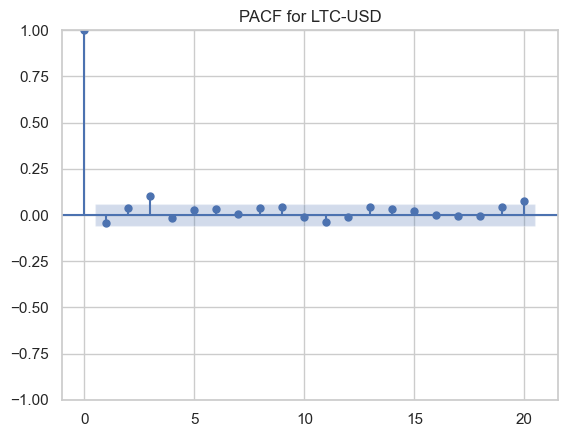

<Figure size 1200x600 with 0 Axes>

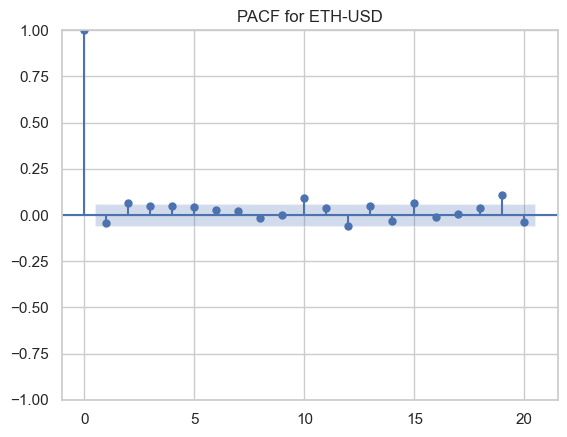

<Figure size 1200x600 with 0 Axes>

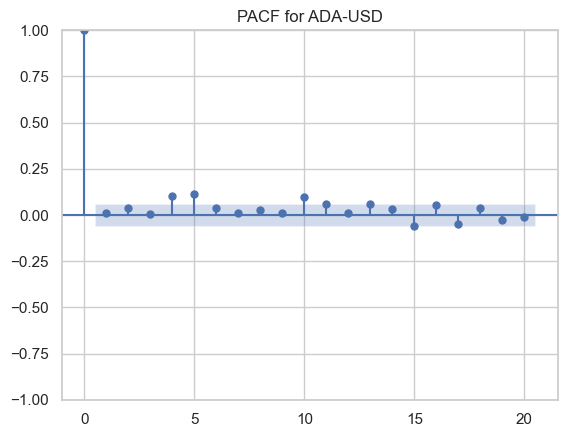

<Figure size 1200x600 with 0 Axes>

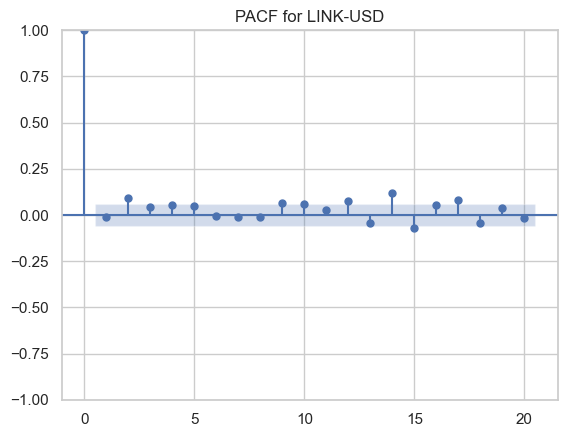

<Figure size 1200x600 with 0 Axes>

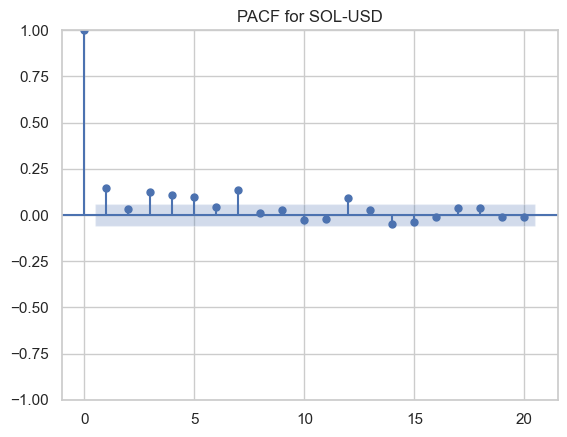

<Figure size 1200x600 with 0 Axes>

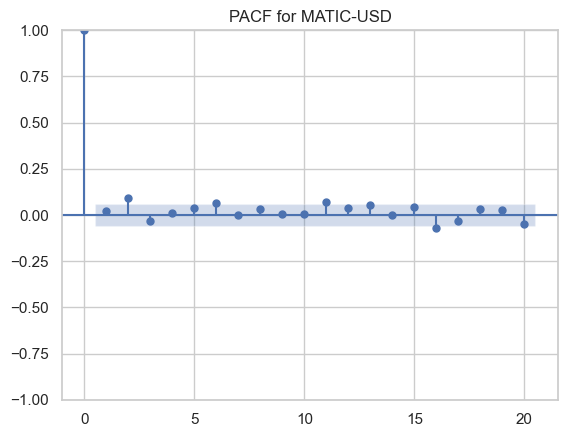

<Figure size 1200x600 with 0 Axes>

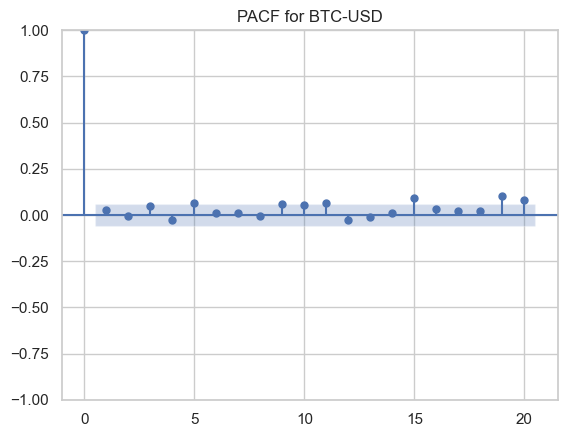

<Figure size 1200x600 with 0 Axes>

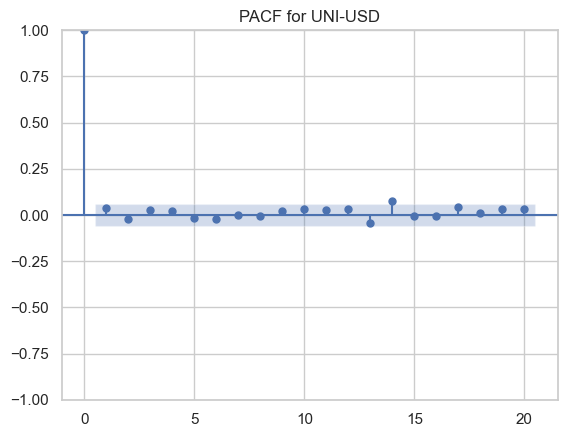

<Figure size 1200x600 with 0 Axes>

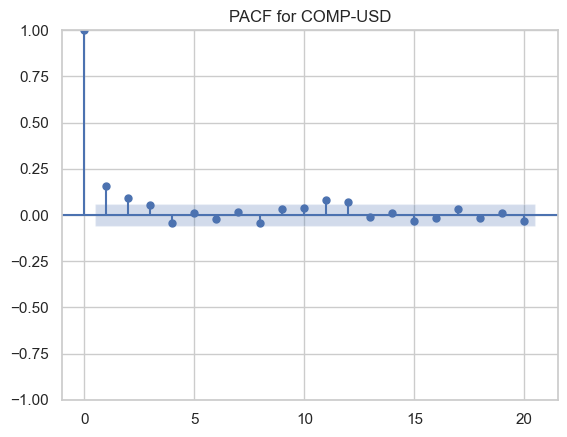

<Figure size 1200x600 with 0 Axes>

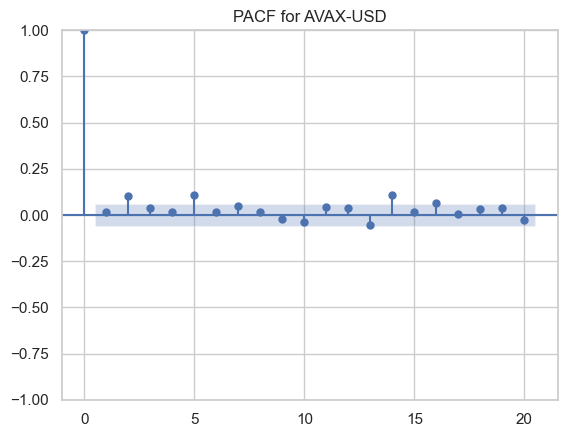

In [88]:
# Function to plot PACF
def plot_pacf_for_coin(coin_data, coin_name, lags=20):
    plt.figure(figsize=(12, 6))
    sm.graphics.tsa.plot_pacf(coin_data.dropna(), lags=lags, title=f'PACF for {coin_name}')
    plt.show()

# Iterate over each cryptocurrency
for coin in df['product_id'].unique():
    # Assuming 'pct_change' is the column of interest
    coin_data = df[df['product_id'] == coin]['pct_change']
    plot_pacf_for_coin(coin_data, coin)

# Pacf (partial auto correlation) look it up!!
Suggestions:
EDA:
- determine whether the data is stationary or not!(Percentage change)!
- Interpret each visual!
- look into time series techniques!

## Final Checks Before Model Development

In [ ]:
# Display final structure of the dataset and check for any anomalies
print("Final Dataset Structure:")
print(df.info())
print("\nSummary Statistics:")
print(df.describe())

# Confirm train-test split
print("\nTraining Set Preview:")
print(train.head())
print("\nTest Set Preview:")
print(test.head())


Final Dataset Structure:
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1041 entries, 2021-08-27 to 2024-07-07
Data columns (total 32 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   low             1041 non-null   float64
 1   high            1041 non-null   float64
 2   open            1041 non-null   float64
 3   close           1041 non-null   float64
 4   volume          1041 non-null   float64
 5   price_change    1041 non-null   float64
 6   average_price   1041 non-null   float64
 7   volatitlity     1041 non-null   float64
 8   product_id      1041 non-null   object 
 9   pct_change      1041 non-null   float64
 10  outlier_flag    1041 non-null   bool   
 11  close_MA10      1041 non-null   float64
 12  RSI             1041 non-null   float64
 13  MACD            1041 non-null   float64
 14  Signal_Line     1041 non-null   float64
 15  close_lag_1     1041 non-null   float64
 16  volume_lag_1    1041 non-null   flo

## Model Development

In [ ]:
# # Prepare the feature matrix and target vector
# features = df.drop(['pct_change', 'product_id'], axis=1)  # Dropping non-numeric and target columns
# target = df['pct_change']

# # Splitting the data into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

# # Initialize the Lasso Regression model with an alpha value
# lasso = Lasso(alpha=0.01, random_state=42)

# # Fit the model to the training data
# lasso.fit(X_train, y_train)

# # Predict on the training and test sets
# train_preds = lasso.predict(X_train)
# test_preds = lasso.predict(X_test)

# # Calculate and print performance metrics
# train_rmse = np.sqrt(mean_squared_error(y_train, train_preds))
# test_rmse = np.sqrt(mean_squared_error(y_test, test_preds))
# train_r2 = r2_score(y_train, train_preds)
# test_r2 = r2_score(y_test, test_preds)

# print(f"Training RMSE: {train_rmse}")
# print(f"Test RMSE: {test_rmse}")
# print(f"Training R^2: {train_r2}")
# print(f"Test R^2: {test_r2}")

Training RMSE: 118.93834628739478
Test RMSE: 70.10071152447318
Training R^2: 0.9999999923884091
Test R^2: 0.9999999882268672


In [19]:
# Put in all the metrics we would wanna display on our streamlit app!
#df[['time', 'open', 'close']].to_csv('RAW_Data/test.csv')